## NOTES:
<ul>
<li>This section is specifically for visualizing the datasets produced by Aquifer Analsys</li>
<li>This section does not generate any new data. Unless otherwise specified, the <strong>input file</strong> for any of these cells is an aquifer analysis spreadsheet of the form <em>Aquifer_Name_Range_Quantile.xlsx</em> </li>
</ul>


## Imports

In [76]:
#Python3.10
import os
import pandas as pd 
import numpy as np
import seaborn as sns
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import calendar
from importlib import reload
import mapclassify as mc
import matplotlib

from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

from matplotlib.ticker import ScalarFormatter
from shapely.geometry import Point

# Custom modules are imported in multiple locations to faciliate easy reloading when edits are made to their respective files
import Src.classes as cl
import Src.func_ko as fn
reload(cl)
reload(fn)

<module 'Src.func_ko' from 'C:\\Users\\kondris\\Documents\\GitHub\\HighMagFlows_EPA_Project\\Src\\func_ko.py'>

## Compare Valid Sites
Compare number of valid sites by % for the 30-year and 50-year records.

### Import national metrics and validity dfs

In [2]:
# All gages - National metrics dfs
data_paths = {
    '30_90': 'Prelim_Data/National_Metrics/National_Metrics_30_90.xlsx',
    '50_90': 'Prelim_Data/National_Metrics/National_Metrics_50_90.xlsx',
    '30_95': 'Prelim_Data/National_Metrics/National_Metrics_30_95.xlsx',
    '50_95': 'Prelim_Data/National_Metrics/National_Metrics_50_95.xlsx'    
}

dfs_metrics = {key: pd.read_excel(path, sheet_name='site_metrics') for key, path in data_paths.items()}

In [3]:
# Converts site_no to strings
date_ranges = ['30', '50']
percentiles = ['90', '95']
for date_range in date_ranges:
    for percentile in percentiles: 
        # Assuming df is your DataFrame and 'column_name' is the name of the column with numbers
        dfs_metrics[f'{date_range}_{percentile}']['site_no'] = dfs_metrics[f'{date_range}_{percentile}']['site_no'].astype(str)  # Convert numbers to strings

        # Add leading '0' to numbers with 7 digits
        dfs_metrics[f'{date_range}_{percentile}']['site_no'] = dfs_metrics[f'{date_range}_{percentile}']['site_no'].apply(lambda x: '0' + x if len(x) == 7 else x)

In [6]:
#len(dfs_metrics['30_90'])
len(dfs_metrics['50_90'])

7914

In [5]:
# Valid gages - National metrics dfs
date_ranges = ['30', '50']
percentiles = ['90', '95']
dfs_valid = {}
for date_range in date_ranges:
    for percentile in percentiles: 
        dfs_valid[f'{date_range}_{percentile}'] = dfs_metrics[f'{date_range}_{percentile}'][dfs_metrics[f'{date_range}_{percentile}']['valid'] == True]

In [52]:
## Aquifer gages
#dfs_valid['30_90']['within_aq'].unique()

selected_aq_list_7 = ['High Plains aquifer',
                'Mississippi River Valley alluvial aquifer',
                'Central Valley aquifer system',
                'Floridan aquifer system',
                'Snake River Plain basaltic-rock aquifers',
                'Coastal lowlands aquifer system',
                'Northern Atlantic Coastal Plain aquifer system']

aq_names_10 = {'High Plains aquifer',
                'Mississippi River Valley alluvial aquifer',
                'Central Valley aquifer system',
                'Basin and Range basin-fill aquifers',
                'Floridan aquifer system',
                'Snake River Plain basaltic-rock aquifers',
                'Coastal lowlands aquifer system',
                'California Coastal Basin aquifers', 
                'Pacific Northwest basin-fill aquifers',
                'Northern Atlantic Coastal Plain aquifer system'}

aq_names_25 = ['Southeastern Coastal Plain aquifer system',
       'Coastal lowlands aquifer system', 'Floridan aquifer system',
       'Valley and Ridge aquifers',
       'Piedmont and Blue Ridge crystalline-rock aquifers',
       'Mississippi embayment aquifer system',
       'Basin and Range basin-fill aquifers',
       'Mississippi River Valley alluvial aquifer',
       'Pacific Northwest basin-fill aquifers',
       'California Coastal Basin aquifers',
       'Central Valley aquifer system',
       'Pacific Northwest basaltic-rock aquifers',
       'Northern Atlantic Coastal Plain aquifer system',
       'Surficial aquifer system', 'Biscayne aquifer',
       'Northern Rocky Mountains Intermontane Basins aquifer system',
       'Snake River Plain basaltic-rock aquifers',
       'Columbia Plateau basaltic-rock aquifers',
       'Cambrian-Ordovician aquifer system', 'Silurian-Devonian aquifers',
       'Lower Cretaceous aquifers', 'High Plains aquifer',
       'Rio Grande aquifer system', 'Edwards-Trinity aquifer system',
       'Willamette Lowland basin-fill aquifers']

dfs_aq = {}
for date_range in date_ranges:
    for percentile in percentiles: 
        dfs_aq[f'{date_range}_{percentile}'] = dfs_valid[f'{date_range}_{percentile}'].loc[dfs_valid[f'{date_range}_{percentile}']['within_aq'].isin(aq_names_25)]
print(len(dfs_aq['30_90']))

1690


In [7]:
datapath = f'Prelim_Data/National_Validity/National_Validity.xlsx'
df_validity = pd.read_excel(datapath, sheet_name='Sheet1')

In [8]:
# print(len(df_validity[(df_validity['date_range_30'] == True) & (df_validity['data_cont_30'] == True)]))
# print(len(df_validity[(df_validity['date_range_30'] == True) & (df_validity['data_cont_30'] == False)]))
# print(len(df_validity[(df_validity['date_range_30'] == False) & (df_validity['data_cont_30'] == True)]))
# print(len(df_validity[(df_validity['date_range_30'] == False) & (df_validity['data_cont_30'] == False)]))
print(len(df_validity))
print(len(dfs_metrics['30_90']))
print(len(dfs_valid['30_90']))
print(len(dfs_metrics['50_90']))
print(len(dfs_valid['50_90']))

8238
7914
4242
7914
3314


### Print number of sites based on different validity criteria

In [9]:
print('--- 90th Percentile---')
df_30_90_valid_metric = dfs_valid['30_90'][(dfs_valid['30_90']['missing_data%'] <= 10) & (dfs_valid['30_90']['analyze_range'] >= 27)]
df_30_90_valid = dfs_valid['30_90'][dfs_valid['30_90']['valid'] == True] # THIS OPTION IS CORRECT
df_30_90_valid_val = df_validity[(df_validity['date_range_30'] == True) & (df_validity['data_cont_30'] == True)]
print('--- 30-Year Valid Gages ---')
print(f'Valid 30-Year gages (missing_data% <= 10 & analyze_range >= 27): {len(df_30_90_valid_metric)}') # 183 difference from last run
print(f'Valid 30-Year gages (valid = True): {len(df_30_90_valid)}')
print(f'Valid 30-Year gages (date_range_30 = True & data_cont_30) = True: {len(df_30_90_valid_val)}')

df_50_90_valid_metric = dfs_valid['50_90'][(dfs_valid['50_90']['missing_data%'] <= 10) & (dfs_valid['50_90']['analyze_range'] >= 45)]
df_50_90_valid = dfs_valid['50_90'][dfs_valid['50_90']['valid'] == True] # THIS OPTION IS CORRECT
df_50_90_valid_val = df_validity[(df_validity['date_range_50'] == True) & (df_validity['data_cont_50'] == True)]
print('--- 50-Year Valid Gages ---')
print(f'Valid 50-Year gages (missing_data% <= 10 & analyze_range >= 45): {len(df_50_90_valid_metric)}') # 183 difference from last run
print(f'Valid 50-Year gages (valid = True): {len(df_50_90_valid)}')
print(f'Valid 50-Year gages (date_range_50 = True & data_cont_50) = True: {len(df_50_90_valid_val)}')

print('--- 95th Percentile---')
df_30_95_valid = dfs_valid['30_95'][dfs_valid['30_95']['valid'] == True] # THIS OPTION IS CORRECT
print(f'Valid 30-Year gages (valid = True): {len(df_30_95_valid)}')
df_50_95_valid = dfs_valid['50_95'][dfs_valid['50_95']['valid'] == True] # THIS OPTION IS CORRECT
print(f'Valid 50-Year gages (valid = True): {len(df_50_95_valid)}')

--- 90th Percentile---
--- 30-Year Valid Gages ---
Valid 30-Year gages (missing_data% <= 10 & analyze_range >= 27): 4242
Valid 30-Year gages (valid = True): 4242
Valid 30-Year gages (date_range_30 = True & data_cont_30) = True: 4265
--- 50-Year Valid Gages ---
Valid 50-Year gages (missing_data% <= 10 & analyze_range >= 45): 3314
Valid 50-Year gages (valid = True): 3314
Valid 50-Year gages (date_range_50 = True & data_cont_50) = True: 3331
--- 95th Percentile---
Valid 30-Year gages (valid = True): 4242
Valid 50-Year gages (valid = True): 3314


### Histogram illustrating % of missing gages for 90/95th percentiles

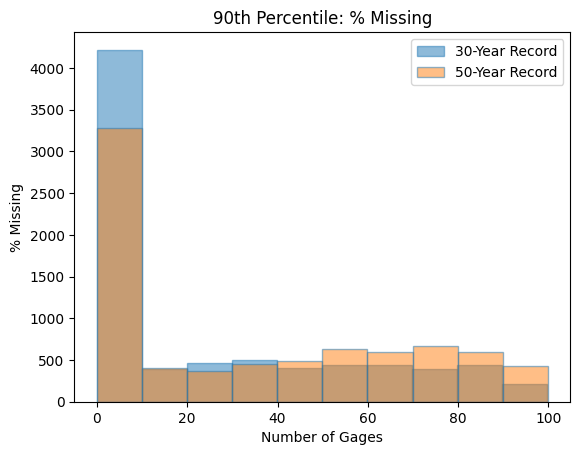

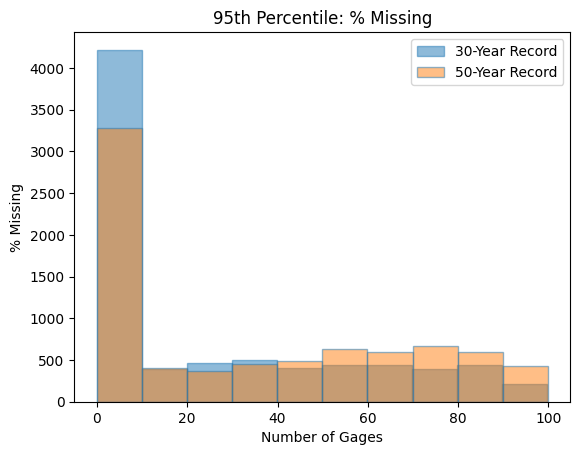

In [14]:
nbins = 10
plt.hist(dfs_metrics['30_90']['missing_data%'], bins=nbins, alpha=0.5, edgecolor='C0', label='30-Year Record')
plt.hist(dfs_metrics['50_90']['missing_data%'], bins=nbins, alpha=0.5, edgecolor='C0', label='50-Year Record')
plt.xlabel('Number of Gages')
plt.ylabel('% Missing')
plt.title('90th Percentile: % Missing')
plt.legend()
plt.show()

plt.hist(dfs_metrics['30_95']['missing_data%'], bins=nbins, alpha=0.5, edgecolor='C0', label='30-Year Record')
plt.hist(dfs_metrics['50_95']['missing_data%'], bins=nbins, alpha=0.5, edgecolor='C0', label='50-Year Record')
plt.xlabel('Number of Gages')
plt.ylabel('% Missing')
plt.title('95th Percentile: % Missing')
plt.legend()
plt.show()

## Select sites that are within the 30-year and 50-year valid sites

In [15]:
def sort_data(df):
    df_sort = df.sort_values(by='threshold')
    df_zero_hmf = df_sort[df_sort['threshold'] == 0]
    df_sort = df_sort[df_sort['threshold'] > 0]
    df_sort['site_no'] = df_sort['site_no'].astype(str)
    return df_sort, df_zero_hmf

df_30_90_sort, df_30_90_zero_hmf = sort_data(dfs_valid['30_90']) # NOTE: 24 gages with 0 cfs as threshold
df_50_90_sort, df_50_90_zero_hmf = sort_data(dfs_valid['50_90']) # NOTE: 12 gages with 0 cfs as threshold
df_30_90_merge = pd.merge(df_30_90_sort, df_50_90_sort, on='site_no', how='inner', suffixes=('_30', '_50')) # only keep rows from second df that appear in first first df
df_90_merge = pd.merge(df_30_90_merge, df_50_90_sort, on='site_no', how='inner', suffixes=('_30', '_50'))
# NOTE: df_90_merge sorted by 30-year threshold (smallest -> largest)

df_30_95_sort, df_30_95_zero_hmf = sort_data(dfs_valid['30_95']) # NOTE: 12 gages with 0 cfs as threshold
df_50_95_sort, df_50_95_zero_hmf = sort_data(dfs_valid['50_95']) # NOTE: 9 gages with 0 cfs as threshold
df_30_95_merge = pd.merge(df_30_95_sort, df_50_95_sort, on='site_no', how='inner', suffixes=('_30', '_50')) # only keep rows from second df that appear in first first df
df_95_merge = pd.merge(df_30_95_merge, df_50_95_sort, on='site_no', how='inner', suffixes=('_30', '_50'))
# NOTE: df_95_merge sorted by 30-year threshold (smallest -> largest)

In [16]:
print('--- 90th Percentile ---')
print(f'30-Year gages (valid = True):', len(dfs_valid['30_90']))
print('30-year gages with threshold > 0 cfs:', len(df_30_90_sort))
print(f'50-Year gages (valid = True):', len(dfs_valid['50_90']))
print('50-year gages with threshold > 0 cfs:', len(df_50_90_sort))
print('50-year gages in 30-year gages list:', len(df_30_90_merge))
print('30-year gages in 50-year gages list:', len(df_90_merge))

print('--- 95th Percentile ---')
print(f'30-Year gages (valid = True):', len(dfs_valid['30_95']))
print('30-year gages with threshold > 0 cfs:', len(df_30_95_sort))
print(f'50-Year gages (valid = True):', len(dfs_valid['50_95']))
print('50-year gages with threshold > 0 cfs:', len(df_50_95_sort))
print('50-year gages in 30-year gages list:', len(df_30_95_merge))
print('30-year gages in 50-year gages list:', len(df_95_merge))

--- 90th Percentile ---
30-Year gages (valid = True): 4242
30-year gages with threshold > 0 cfs: 4218
50-Year gages (valid = True): 3314
50-year gages with threshold > 0 cfs: 3302
50-year gages in 30-year gages list: 3241
30-year gages in 50-year gages list: 3241
--- 95th Percentile ---
30-Year gages (valid = True): 4242
30-year gages with threshold > 0 cfs: 4230
50-Year gages (valid = True): 3314
50-year gages with threshold > 0 cfs: 3305
50-year gages in 30-year gages list: 3244
30-year gages in 50-year gages list: 3244


In [17]:
print(df_30_90_zero_hmf['site_no'].tolist())
print(df_50_90_zero_hmf['site_no'].tolist())

['08401900', '11122010', '11077500', '09486800', '09487000', '09512162', '09513860', '09517490', '09520280', '08202700', '13132513', '08185000', '10262500', '10259300', '10259100', '10259050', '09419740', '09419756', '09482000', '08405150', '08404000', '08401200', '08398500', '08400000']
['10262500', '09513860', '08185000', '10259300', '08202700', '08398500', '11077500', '08400000', '08401200', '08405150', '08401900', '08404000']


### Log plot of 30 vs. 50-year thresholds for all gages

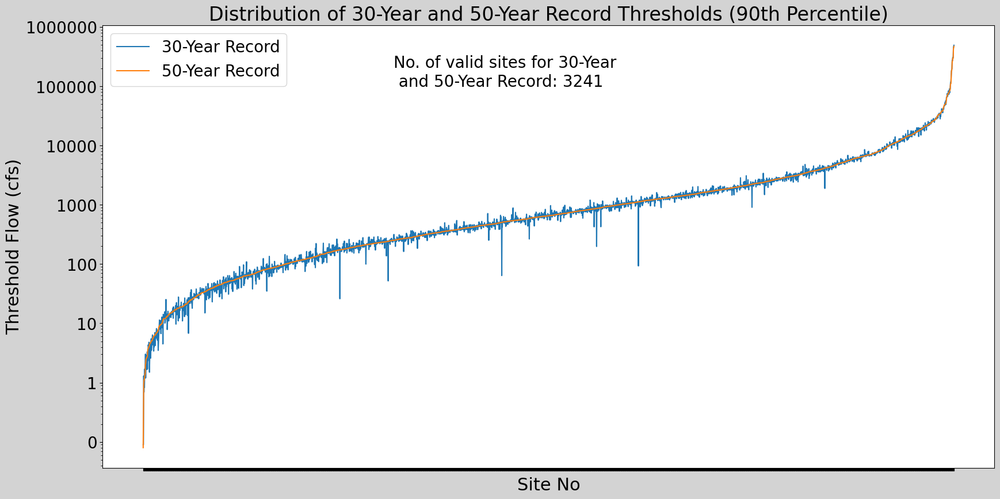

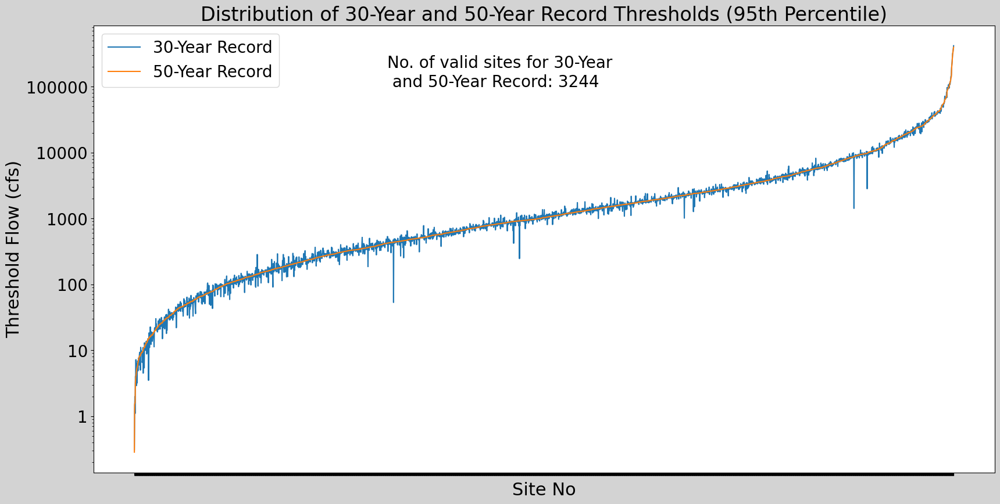

In [18]:
def plot_threshold_log(df, sort_date_range, start_value, end_value, percentile, save:True):
    fig, ax = plt.subplots(figsize=(20, 10), facecolor='lightgrey')

    df = df.sort_values(by=sort_date_range)
    
    if sort_date_range == 'threshold_50':
        ax.semilogy(df['site_no'][start_value:end_value], df['threshold_30'][start_value:end_value], color='C0', label='30-Year Record')
        ax.semilogy(df['site_no'][start_value:end_value], df['threshold_50'][start_value:end_value], color='C1', label='50-Year Record')
    elif sort_date_range == 'threshold_30':
        ax.semilogy(df['site_no'][start_value:end_value], df['threshold_50'][start_value:end_value], color='C1', label='50-Year Record')
        ax.semilogy(df['site_no'][start_value:end_value], df['threshold_30'][start_value:end_value], color='C0', label='30-Year Record')

    formatter = ScalarFormatter()
    formatter.set_scientific(False)  # Disable scientific notation
    plt.gca().yaxis.set_major_formatter(formatter)

    ax.set_xlabel('Site No', fontsize=22)
    ax.set_ylabel('Threshold Flow (cfs)', fontsize=22)
    ax.tick_params(axis='x',  rotation=90)
    ax.tick_params(axis='y', labelsize=20)
    plt.gca().set_xticklabels([])
    
    plt.title(f'Distribution of 30-Year and 50-Year Record Thresholds ({percentile}th Percentile)', fontsize=24)

    plt.legend(fontsize=20)
    
    if percentile == '90':
        plt.text(1000, 100000, f'No. of valid sites for 30-Year \n and 50-Year Record: {len(df_90_merge)}', fontsize=20)
    else:
        plt.text(1000, 100000, f'No. of valid sites for 30-Year \n and 50-Year Record: {len(df_95_merge)}', fontsize=20)

    if save == True:
        plt.savefig(f'Saved_Visuals/Valid_gages/threshold_compare_log_{sort_date_range}_{percentile}.png', bbox_inches='tight')
    plt.show()
    return

#plot_threshold_log(df_90_merge, 'threshold_50', 0, 500, '90', False)
plot_threshold_log(df_90_merge, 'threshold_50', 0, len(df_90_merge), '90', True)
plot_threshold_log(df_95_merge, 'threshold_50', 0, len(df_90_merge), '95', True)

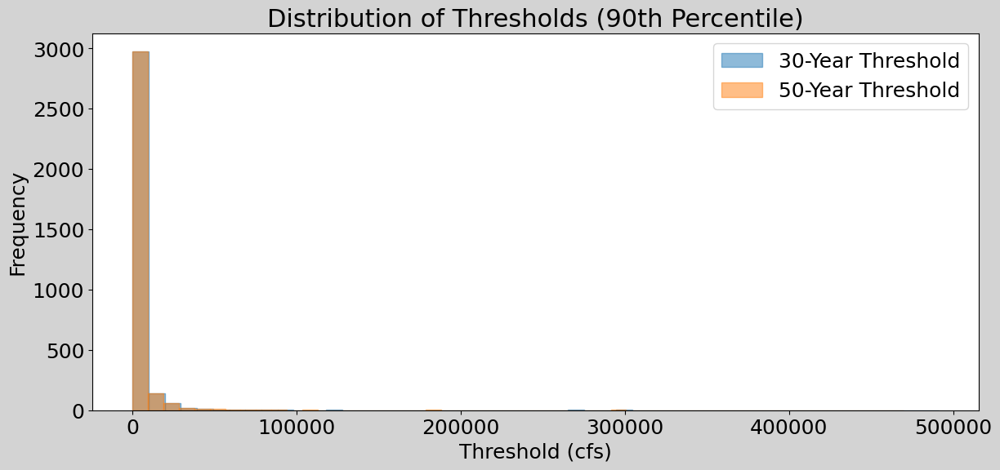

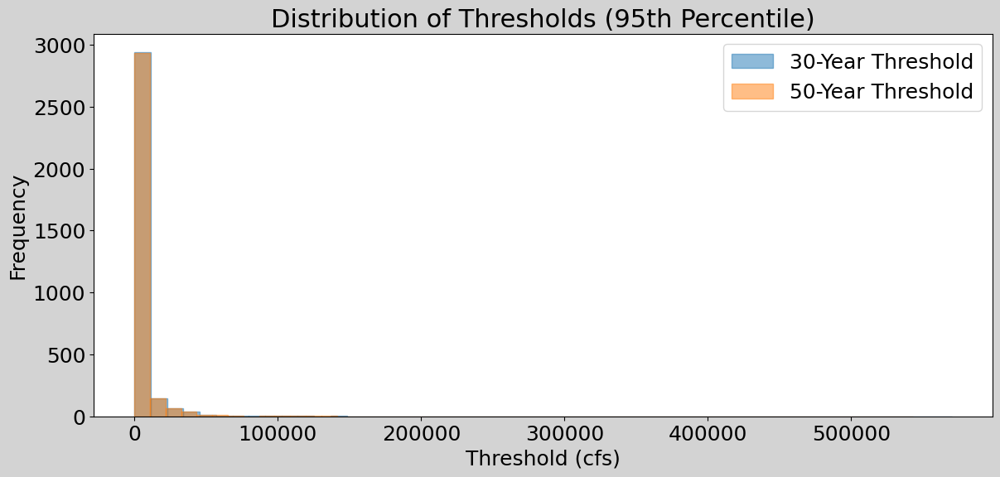

In [19]:
# Histogram of thresholds by frequnecy
def histogram_thresholds(df, percentile):
    plt.figure(figsize=(14, 6), facecolor='lightgrey')
    plt.hist(df['threshold_30'], bins=50, alpha=0.5, color='C0', edgecolor='C0', label='30-Year Threshold')
    plt.hist(df['threshold_50'], bins=50, alpha=0.5, color='C1', edgecolor='C1', label='50-Year Threshold')
    plt.xlabel('Threshold (cfs)', fontsize=18)
    plt.ylabel('Frequency', fontsize=18)
    plt.title(f'Distribution of Thresholds ({percentile}th Percentile)', fontsize=22)
    plt.tick_params(axis='both', which='major', labelsize=18)
    plt.legend(fontsize=18)
    plt.savefig(f'Saved_Visuals/Valid_gages/threshold_compare_hist_{percentile}.png', bbox_inches='tight')
    plt.show()
    
histogram_thresholds(df_90_merge, '90')
histogram_thresholds(df_95_merge, '95')

## Calculate the percent deviation in the 30 vs. 50-year thresholds

In [20]:
# Calculate how much higher the 30-year threshold is than the 50-year threshold
df_90_merge['pct_diff'] = (df_90_merge['threshold_30'] - df_90_merge['threshold_50']) / df_90_merge['threshold_50'] * 100
df_95_merge['pct_diff'] = (df_95_merge['threshold_30'] - df_95_merge['threshold_50']) / df_95_merge['threshold_50'] * 100

In [231]:
# Scatter plot illustrating percent change in 30-yr vs. 50-year record thresholds
# fig, ax = plt.subplots(figsize=(20, 5), facecolor='lightgrey')
# df_90_merge_resort = df_90_merge.sort_values(by='threshold_50')
# ax.plot(df_90_merge_resort['site_no'], df_90_merge_resort['pct_diff'], label='90th perc.')
# #df_95_merge_resort = df_95_merge.sort_values(by='threshold_50')
# #ax.plot(df_95_merg_resorte['site_no'], df_95_merge_resort['pct_diff'], label='95th perc.')
# ax.set_ylabel('Percent Change')
# plt.show()

### Histogram of 30 vs. 50-year threshold deviation

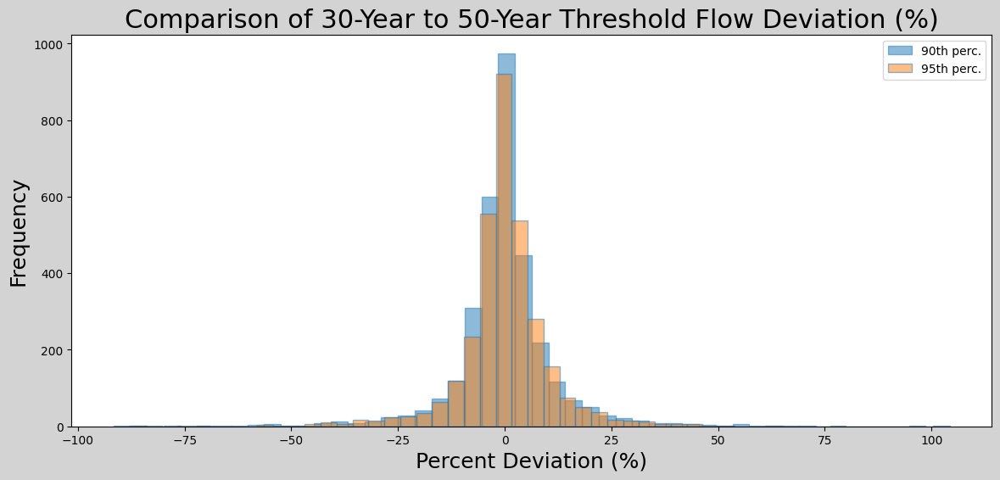

In [21]:
plt.figure(figsize=(14, 6), facecolor='lightgrey')
plt.hist(df_90_merge['pct_diff'], bins=50, alpha=0.5, edgecolor='C0', label='90th perc.')
plt.hist(df_95_merge['pct_diff'], bins=50, alpha=0.5, edgecolor='C0', label='95th perc.')
plt.xlabel('Percent Deviation (%)', fontsize=18)
plt.ylabel('Frequency', fontsize=18)
plt.title('Comparison of 30-Year to 50-Year Threshold Flow Deviation (%)', fontsize=22)
plt.legend()
plt.savefig(f'Saved_Visuals/Valid_gages/threshold_pct_diff_hist.png', bbox_inches='tight')
plt.show()

### Boxplots and maps of 30 vs. 50-year threshold deviation

In [32]:
# Function to map gages by percent deviation
def pct_diff_map(df, percentile, upper_whisker, lower_whisker, Q1, Q3):
    trend_options = ['higher_outliers', 'lower_outliers', 'higher_75perc', 'lower_25perc', 'iqr']
    colors = {'higher_outliers': 'blue', 'lower_outliers': 'red', 'higher_75perc': 'green', 'lower_25perc':'orange', 'iqr': 'yellow'}
    markers = {'higher_outliers': '^', 'lower_outliers': 'v', 'higher_75perc': '^', 'lower_25perc':'v', 'iqr': 'o'}
    labels = {'higher_outliers': '% Deviation > Max', 'lower_outliers': '% Deviation < Min', 
              'higher_75perc': 'Q3 < % Deviation < Max', 'lower_25perc':'Min < % Deviation < Q1', 'iqr': 'Q1 < % Deviation < Q3'}
    markersizes = {'higher_outliers': 500, 'lower_outliers': 500, 'higher_75perc': 200, 'lower_25perc':200, 'iqr': 50}
    
    fig, ax = plt.subplots(figsize=(35, 35))

    lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
    #lower48 = lower48.to_crs(epsg=4269)
    lower48 = lower48.to_crs('ESRI:102003')
    lower48.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.0) 

    # aq_names = [aq.name for aq in aquifers]
    # aq_gdf = aq_shape[aq_shape['aq_name'].isin(aq_names)]
    # aq_gdf = aq_gdf.to_crs(epsg=4269)
    # #aq_gdf = aq_gdf.to_crs('ESRI:102003')
    # aq_gdf.plot(ax=ax, edgecolor='black', facecolor='purple', linewidth=1.5, alpha=0.2)

    # Gages plot, with points marked by MK trend
    # lat = df['dec_lat_va'].tolist()
    # long = df['dec_long_va'].tolist()
    # geometry = [Point(xy) for xy in zip(long, lat)]
    # geo_df = gpd.GeoDataFrame(geometry=geometry)
    #bx = geo_df.plot(ax=ax, color='red', marker='o', markersize=100, edgecolor='black', linewidth=1, alpha=0.75, legend=True)

    for trend_opt in trend_options:
        if trend_opt == 'iqr':
            df_subset = df[(df['pct_diff'] > Q1) & (df['pct_diff'] < Q3)]
            lat = df_subset['dec_lat_va'].tolist()
            long = df_subset['dec_long_va'].tolist()
            geometry = [Point(xy) for xy in zip(long, lat)]
            geo_subset = gpd.GeoDataFrame(geometry=geometry)
            geo_subset = geo_subset.set_crs('ESRI:102003')
            geo_subset = geo_subset.to_crs('ESRI:102003')
            #geo_subset = geo_df.iloc[df_subset.index]
            bx = geo_subset.plot(ax=ax, color=colors[trend_opt], marker=markers[trend_opt], markersize=markersizes[trend_opt], 
                                 label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)    
        elif trend_opt == 'higher_outliers':
            df_subset = df[(df['pct_diff'] > upper_whisker)]
            lat = df_subset['dec_lat_va'].tolist()
            long = df_subset['dec_long_va'].tolist()
            geometry = [Point(xy) for xy in zip(long, lat)]
            geo_subset = gpd.GeoDataFrame(geometry=geometry)
            #geo_subset = geo_df.iloc[df_subset.index]
            bx = geo_subset.plot(ax=ax, color=colors[trend_opt], marker=markers[trend_opt], markersize=markersizes[trend_opt], 
                                 label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)
        elif trend_opt == 'higher_75perc':
            df_subset = df[(df['pct_diff'] < upper_whisker) & (df['pct_diff'] > Q3)]
            lat = df_subset['dec_lat_va'].tolist()
            long = df_subset['dec_long_va'].tolist()
            geometry = [Point(xy) for xy in zip(long, lat)]
            geo_subset = gpd.GeoDataFrame(geometry=geometry)
            #geo_subset = geo_df.iloc[df_subset.index]
            bx = geo_subset.plot(ax=ax, color=colors[trend_opt], marker=markers[trend_opt], markersize=markersizes[trend_opt], 
                                 label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)
        elif trend_opt == 'lower_25perc':
            df_subset = df[(df['pct_diff'] > lower_whisker) & (df['pct_diff'] < Q1)]
            lat = df_subset['dec_lat_va'].tolist()
            long = df_subset['dec_long_va'].tolist()
            geometry = [Point(xy) for xy in zip(long, lat)]
            geo_subset = gpd.GeoDataFrame(geometry=geometry)
            #geo_subset = geo_df.iloc[df_subset.index]
            bx = geo_subset.plot(ax=ax, color=colors[trend_opt], marker=markers[trend_opt], markersize=markersizes[trend_opt], 
                                 label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)
        elif trend_opt == 'lower_outliers':
            df_subset = df[(df['pct_diff'] < lower_whisker)]
            lat = df_subset['dec_lat_va'].tolist()
            long = df_subset['dec_long_va'].tolist()
            geometry = [Point(xy) for xy in zip(long, lat)]
            geo_subset = gpd.GeoDataFrame(geometry=geometry)
            #geo_subset = geo_df.iloc[df_subset.index]
            bx = geo_subset.plot(ax=ax, color=colors[trend_opt], marker=markers[trend_opt], markersize=markersizes[trend_opt], 
                                 label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)

    plt.title(f'Comparison of 30-Year to 50-Year Threshold Flow Deviation (%) \n ({percentile}th Percentile)', fontsize=36)
    plt.legend(fontsize=28)

    plt.axis("off")

    plt.tight_layout()
    plt.savefig(f'Saved_Visuals/Valid_gages/outlier_gages_map_{percentile}.png', bbox_inches='tight')
    plt.show()
    return

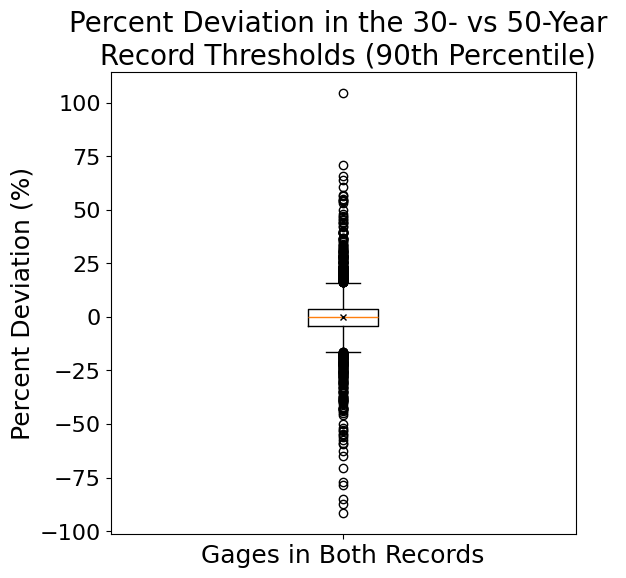

25th Percentile: -4.285714285714286
Median: 0.0
Mean: -0.12125203899181597
75th Percentile: 3.8437500000003455
Lower whisker: -16.47991071428623
Upper whisker: 16.03794642857229


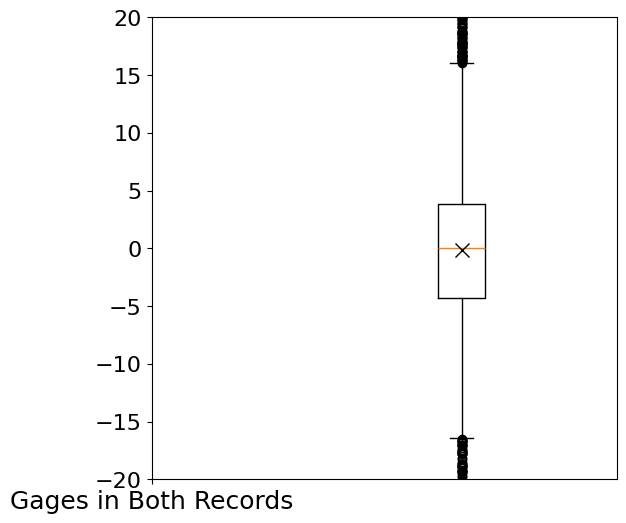

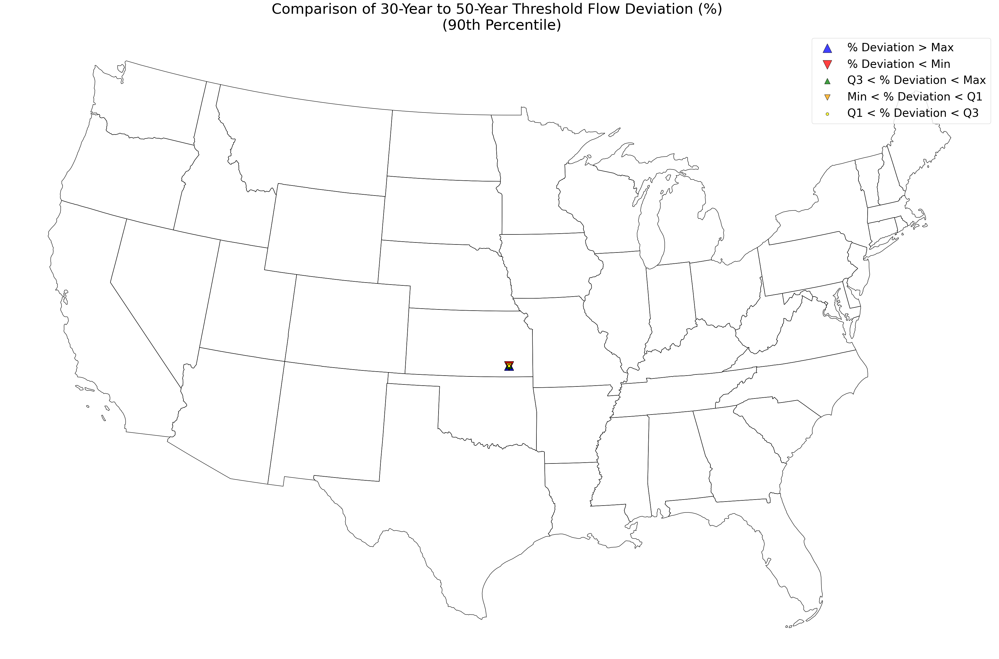

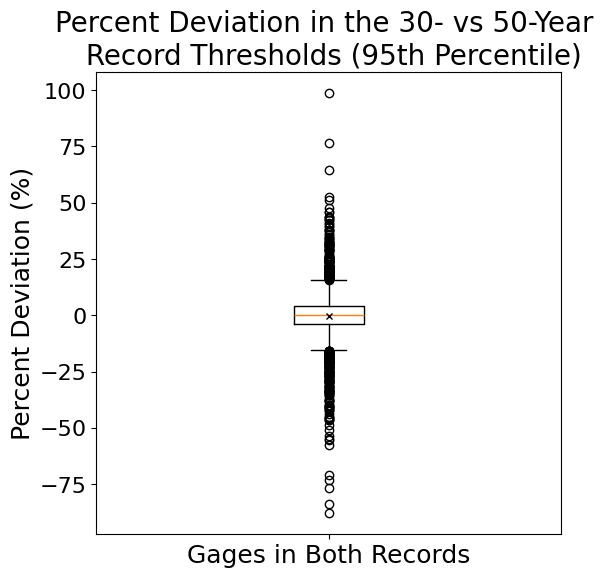

25th Percentile: -3.8461538461538463
Median: 0.0
Mean: -0.08767359438681442
75th Percentile: 4.0
Lower whisker: -15.615384615384617
Upper whisker: 15.76923076923077


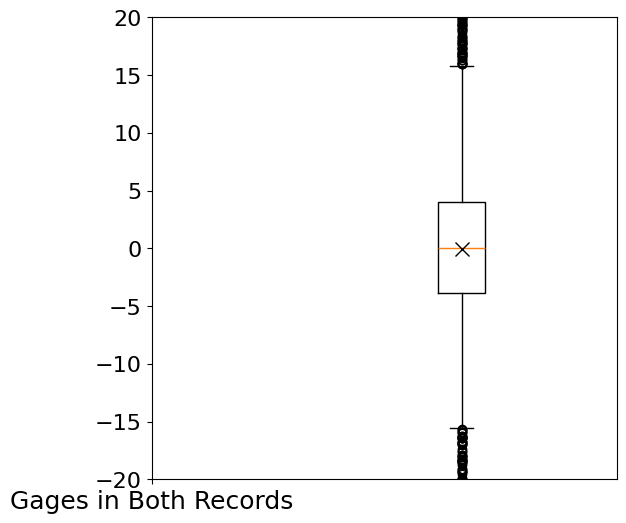

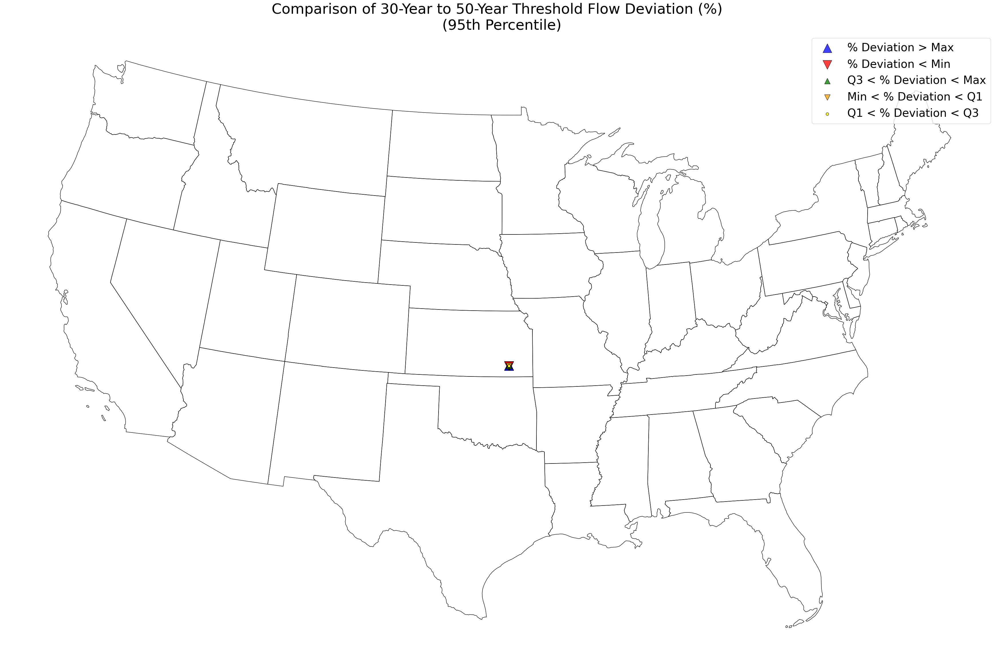

In [33]:
# Box plot of percent change
def pct_diff_boxplot(df, percentile, map=True):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.boxplot(df['pct_diff'], showmeans=True, meanprops=dict(marker='x', markerfacecolor='black', markeredgecolor='black', markersize=5))
    #ax.boxplot(None, showmeans=True)
    ax.set_xticks([1], ['Gages in Both Records'], fontsize=18)
    ax.set_ylabel('Percent Deviation (%)', fontsize=18)
    ax.tick_params(axis='y', labelsize=16)
    plt.title(f'Percent Deviation in the 30- vs 50-Year \n Record Thresholds ({percentile}th Percentile)', fontsize=20)
    plt.savefig(f'Saved_Visuals/Valid_gages/threshold_compare_boxplot_{percentile}.png', bbox_inches='tight')
    plt.show()

    Q1 = np.percentile(df['pct_diff'], 25)
    Q3 = np.percentile(df['pct_diff'], 75)
    IQR = Q3 - Q1
    lower_whisker = np.percentile(df['pct_diff'], 0) if Q1 - 1.5 * IQR < np.min(df['pct_diff']) else Q1 - 1.5 * IQR
    upper_whisker = np.percentile(df['pct_diff'], 100) if Q3 + 1.5 * IQR > np.max(df['pct_diff']) else Q3 + 1.5 * IQR

    print('25th Percentile:', Q1)
    print('Median:', np.median(df['pct_diff']))
    print('Mean:', np.mean(df['pct_diff']))
    print('75th Percentile:', Q3)
    print("Lower whisker:", lower_whisker)
    print("Upper whisker:", upper_whisker)
    
    # Zoomed in plot
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.boxplot(df['pct_diff'], showmeans=True, meanprops=dict(marker='x', markerfacecolor='black', markeredgecolor='black', markersize=10))
    ax.set_xticks([0], ['Gages in Both Records'], fontsize=18)
    #ax.set_ylabel('Percent Deviation (%)', fontsize=18)
    ax.set_ylim(-20, 20)
    ax.tick_params(axis='y', labelsize=16)
    # plt.gca().spines['top'].set_visible(False)
    # plt.gca().spines['right'].set_visible(False)
    # plt.gca().spines['bottom'].set_visible(False)
    # plt.gca().spines['left'].set_visible(False)
    #plt.title(f'Percent Deviation in the 30- vs 50-Year \n Record Thresholds ({percentile}th Percentile)', fontsize=20)
    plt.savefig(f'Saved_Visuals/Valid_gages/threshold_compare_boxplot_{percentile}_zoom.png', bbox_inches='tight')
    plt.show()
    
    if map == True:
        pct_diff_map(df, percentile, upper_whisker, lower_whisker, Q1, Q3)
    else:
        pass
    
    return 

pct_diff_boxplot(df_90_merge, '90', True)
pct_diff_boxplot(df_95_merge, '95', True)

In [263]:
df_90_merge_edit = df_90_merge.copy()
df_90_merge_edit['pct_diff_inter_ann'] = (df_90_merge['inter_annual%_30'] - df_90_merge['inter_annual%_50']) / df_90_merge['inter_annual%_50'] * 100

df_95_merge_edit = df_95_merge.copy()
df_95_merge_edit['pct_diff_inter_ann'] = (df_95_merge['inter_annual%_30'] - df_95_merge['inter_annual%_50']) / df_95_merge['inter_annual%_50'] * 100

#upper_outliers = df_90_merge[df_90_merge['pct_diff'] > 16.02]
df_90_merge_edit = df_90_merge_edit.sort_values(by='pct_diff')
df_95_merge_edit = df_95_merge_edit.sort_values(by='pct_diff')
#upper_outliers.columns.tolist()

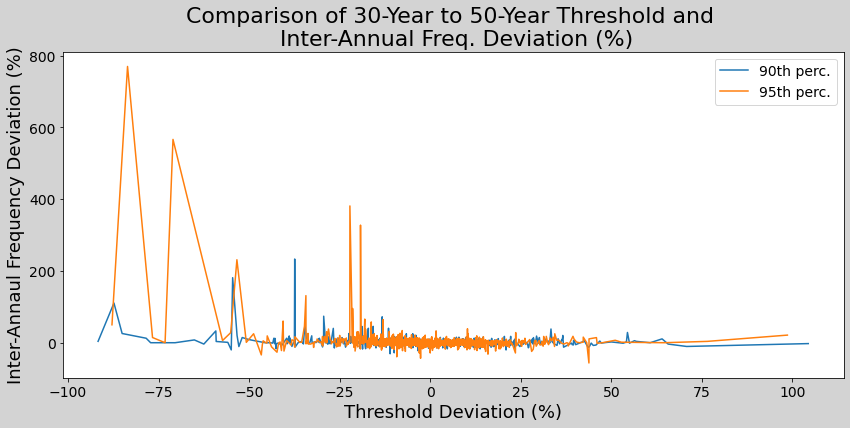

In [268]:
plt.figure(figsize=(14, 6), facecolor='lightgrey')
plt.plot(df_90_merge_edit['pct_diff'], df_90_merge_edit['pct_diff_inter_ann'], label='90th perc.')
plt.plot(df_95_merge_edit['pct_diff'], df_95_merge_edit['pct_diff_inter_ann'], label='95th perc.')
plt.xlabel('Threshold Deviation (%)', fontsize=18)
plt.ylabel('Inter-Annaul Frequency Deviation (%)', fontsize=18)
plt.title('Comparison of 30-Year to 50-Year Threshold and \n Inter-Annual Freq. Deviation (%)', fontsize=22)
plt.tick_params(axis='both', which='both', labelsize=14)
plt.legend(fontsize=14)
plt.savefig(f'Saved_Visuals/Valid_gages/threshold_pct_diff_inter_ann_scatter.png', bbox_inches='tight')
plt.show()

In [249]:
# QA/QC PERCENT DIFFERENCE
# percentile = '90'
# fig, ax = plt.subplots(figsize=(8, 6))
# ax.boxplot(df_90_merge['pct_diff'], showmeans=True)
# ax.set_xticks([1], ['All Overlapping Sites'], fontsize=18)
# ax.set_ylabel('Percent Difference (%)', fontsize=18)
# ax.tick_params(axis='y', labelsize=16)
# plt.title(f'Boxplot Illustrating the Percent Difference in the \n 30- vs 50-Year Record Thresholds ({percentile}th Percentile)', fontsize=20)
# plt.savefig(f'Saved_Visuals/Valid_gages/threshold_compare_boxplot_{percentile}.png', bbox_inches='tight')
# plt.show()

# Q1 = np.percentile(df_90_merge['pct_diff'], 25)
# Q3 = np.percentile(df_90_merge['pct_diff'], 75)
# IQR = Q3 - Q1
# lower_whisker = np.percentile(df_90_merge['pct_diff'], 0) if Q1 - 1.5 * IQR < np.min(df_90_merge['pct_diff']) else Q1 - 1.5 * IQR
# upper_whisker = np.percentile(df_90_merge['pct_diff'], 100) if Q3 + 1.5 * IQR > np.max(df_90_merge['pct_diff']) else Q3 + 1.5 * IQR

# print('25th Percentile:', Q1)
# print('Median:', np.median(df_90_merge['pct_diff']))
# print('Mean:', np.mean(df_90_merge['pct_diff']))
# print('75th Percentile:', Q3)
# print("Lower whisker:", lower_whisker)
# print("Upper whisker:", upper_whisker)

# trend_options = ['higher_outliers', 'lower_outliers', 'higher_75perc', 'lower_25perc', 'iqr']
# colors = {'higher_outliers': 'red', 'lower_outliers': 'blue', 'higher_75perc': 'orange', 'lower_25perc':'green', 'iqr': 'yellow'}
# markers = {'higher_outliers': '^', 'lower_outliers': 'v', 'higher_75perc': '^', 'lower_25perc':'v', 'iqr': 'o'}
# labels = {'higher_outliers': '% Deviation > Max', 'lower_outliers': '% Deviation < Min', 
#           'higher_75perc': 'Q3 < % Deviation < Max', 'lower_25perc':'Min < % Deviation < Q1', 'iqr': 'Q1 < % Deviation < Q3'}
# markersizes = {'higher_outliers': 500, 'lower_outliers': 500, 'higher_75perc': 200, 'lower_25perc':200, 'iqr': 50}

# ############################################

# fig, ax = plt.subplots(figsize=(35, 35))

# lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
# lower48 = lower48.to_crs(epsg=4269)
# #lower48 = lower48.to_crs('ESRI:102003')
# lower48.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.0) 

# #print(df_90_merge[['dec_long_va', 'dec_lat_va', 'pct_diff']][0:15])
# lat = df_90_merge['dec_lat_va'].tolist()
# long = df_90_merge['dec_long_va'].tolist()
# geometry = [Point(xy) for xy in zip(long, lat)]
# geo_df = gpd.GeoDataFrame(geometry=geometry)
# print(geo_df[0:15])
# df_subset = df_90_merge[(df_90_merge['pct_diff'] > upper_whisker)]
# print(df_subset[['dec_long_va', 'dec_lat_va', 'pct_diff']][0:15])
# geo_subset = geo_df.iloc[df_subset.index]
# print(geo_subset[0:15])
# bx = geo_subset.plot(ax=ax, color=colors[trend_opt], marker=markers[trend_opt], markersize=markersizes[trend_opt], 
#                      label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)  

# plt.title(f'Comparison of 30-Year to 50-Year Threshold Flow Deviation (%) \n ({percentile}th Percentile)', fontsize=36)
# plt.legend(fontsize=28)
# plt.axis("off")
# plt.tight_layout()
# #plt.savefig(f'Saved_Visuals/Valid_gages/outlier_gages_map_{percentile}.png', bbox_inches='tight')
# plt.show()

# ############################################

# fig, ax = plt.subplots(figsize=(35, 35))

# lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
# lower48 = lower48.to_crs(epsg=4269)
# #lower48 = lower48.to_crs('ESRI:102003')
# lower48.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.0) 

# print(df_90_merge[['dec_long_va', 'dec_lat_va', 'pct_diff']][0:15])
# df_subset2 = df_90_merge[(df_90_merge['pct_diff'] > upper_whisker)]
# print(df_subset2[['dec_long_va', 'dec_lat_va']][0:15])
# lat2 = df_subset2['dec_lat_va'].tolist()
# long2 = df_subset2['dec_long_va'].tolist()
# geometry2 = [Point(xy) for xy in zip(long2, lat2)]
# geo_subset2 = gpd.GeoDataFrame(geometry=geometry2)
# print(geo_subset2[0:15])
# bx = geo_subset2.plot(ax=ax, color=colors[trend_opt], marker=markers[trend_opt], markersize=markersizes[trend_opt], 
#                      label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)  

# plt.title(f'Comparison of 30-Year to 50-Year Threshold Flow Deviation (%) \n ({percentile}th Percentile)', fontsize=36)
# plt.legend(fontsize=28)
# plt.axis("off")
# plt.tight_layout()
# #plt.savefig(f'Saved_Visuals/Valid_gages/outlier_gages_map_{percentile}.png', bbox_inches='tight')
# plt.show()

In [250]:
# Plotting sites with different thresholds
lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
aq_shape = gpd.read_file('ShapeFiles/Aquifers/_Master_Aquifer/master_aquifer.shp')
streams = gpd.read_file('ShapeFiles/Streams_US/us_streams.shp')
counties_us = gpd.read_file('ShapeFiles/Counties_US/cb_2018_us_county_20m.shp')

aquifers = cl.ALL_AQUIFERS

# All gages - National metrics dfs

In [5]:
# All gages - National metrics dfs
data_paths = {
    '30_90': 'Prelim_Data/National_Metrics/National_Metrics_30_90.xlsx',
    '50_90': 'Prelim_Data/National_Metrics/National_Metrics_50_90.xlsx',
    '30_95': 'Prelim_Data/National_Metrics/National_Metrics_30_95.xlsx',
    '50_95': 'Prelim_Data/National_Metrics/National_Metrics_50_95.xlsx'    
}

dfs_metrics = {key: pd.read_excel(path, sheet_name='site_metrics') for key, path in data_paths.items()}

In [6]:
# Valid gages - National metrics dfs
date_ranges = ['30', '50']
percentiles = ['90', '95']
dfs_valid = {}
for date_range in date_ranges:
    for percentile in percentiles: 
        dfs_valid[f'{date_range}_{percentile}'] = dfs_metrics[f'{date_range}_{percentile}'][dfs_metrics[f'{date_range}_{percentile}']['valid'] == True]

### OR upload valid gages only with station names

In [3]:
# Dataset upload
data_paths = {
    '30_90': 'Prelim_Data/National_Metrics/Station_names/National_Metrics_30_90.xlsx',
    '50_90': 'Prelim_Data/National_Metrics/Station_names/National_Metrics_50_90.xlsx',
    '30_95': 'Prelim_Data/National_Metrics/Station_names/National_Metrics_30_95.xlsx',
    '50_95': 'Prelim_Data/National_Metrics/Station_names/National_Metrics_50_95.xlsx'    
}

#dfs_metrics = {key: pd.read_excel(path, sheet_name='site_metrics') for key, path in data_paths.items()}
dfs_valid = {key: pd.read_excel(path) for key, path in data_paths.items()}

NameError: name 'pd' is not defined

### Import national metrics with new metrics (percent HMF)

In [30]:
data_paths = {
    '30_90': 'Prelim_Data/National_Metrics/National_Metrics_update_30_90.xlsx',
    '50_90': 'Prelim_Data/National_Metrics/National_Metrics_update_50_90.xlsx',
    '30_95': 'Prelim_Data/National_Metrics/National_Metrics_update_30_95.xlsx',
    '50_95': 'Prelim_Data/National_Metrics/National_Metrics_update_50_95.xlsx'    
}

dfs_valid_update = {key: pd.read_excel(path) for key, path in data_paths.items()}

In [31]:
# Converts site_no to strings
date_ranges = ['30', '50']
percentiles = ['90', '95']
for date_range in date_ranges:
    for percentile in percentiles: 
        # Assuming df is your DataFrame and 'column_name' is the name of the column with numbers
        dfs_valid_update[f'{date_range}_{percentile}']['site_no'] = dfs_valid_update[f'{date_range}_{percentile}']['site_no'].astype(str)  # Convert numbers to strings

        # Add leading '0' to numbers with 7 digits
        dfs_valid_update[f'{date_range}_{percentile}']['site_no'] = dfs_valid_update[f'{date_range}_{percentile}']['site_no'].apply(lambda x: '0' + x if len(x) == 7 else x)

### MAR gages

In [249]:
# MAR gages
mar_gages = ['11152500', '11274000', '13087995', '13142500', '13147900', '14018500', '06711565', '06764880', '09486520', '09486520', '07077555',
             '08175800']
mar_gages_string = list(map(int, mar_gages))
percentile = '90'
date_range = '30'
df = dfs_valid[f'{date_range}_{percentile}']
df_mar = df[df['site_no'].isin(mar_gages_string)]

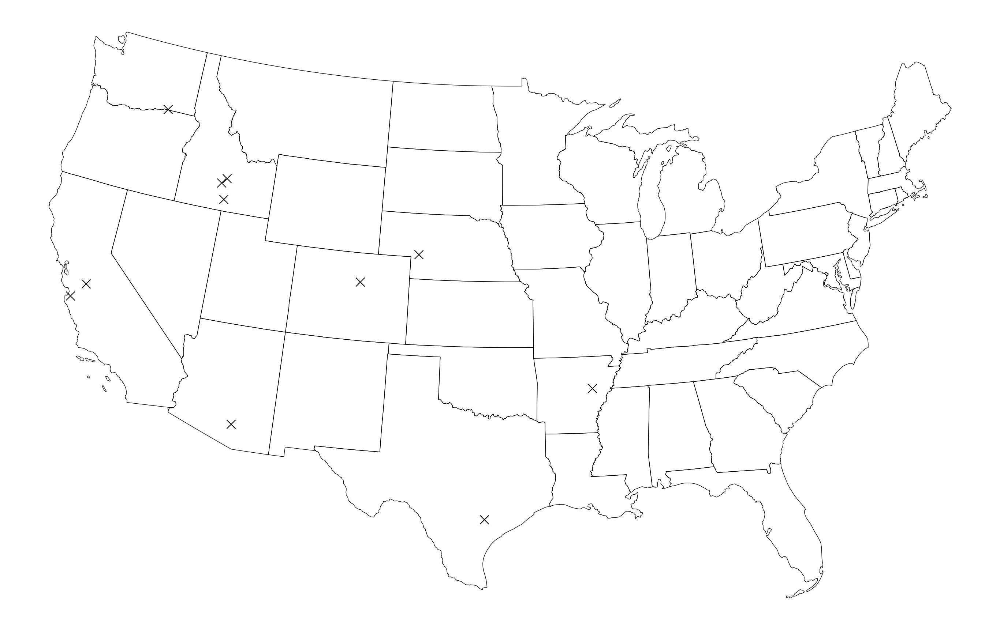

In [264]:
df = df_mar
metric = 'annual_hmf'

fig, ax = plt.subplots(figsize=(35, 35))

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.0) 

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

# Plot gauges
geo_df.plot(ax=ax, color='black', label=f'MAR Gages)', markersize=300, marker='x', alpha=1.0, legend=True)

plt.axis("off")

plt.show()

## Plot of Single HMF Metric (natural break or percentile)

In [105]:
type = 'percentile'
metric = 'annual_hmf' #'timing' #'intra_annual' #'event_hmf' #'event_duration' #'annual_duration' #'annual_hmf' #'inter_annual%'
extent = 'conus' #'aq25'

In [18]:
df = dfs_valid[f'30_90']
df['annual_hmf'].quantile(0.75)

np.float64(0.16278724799988153)

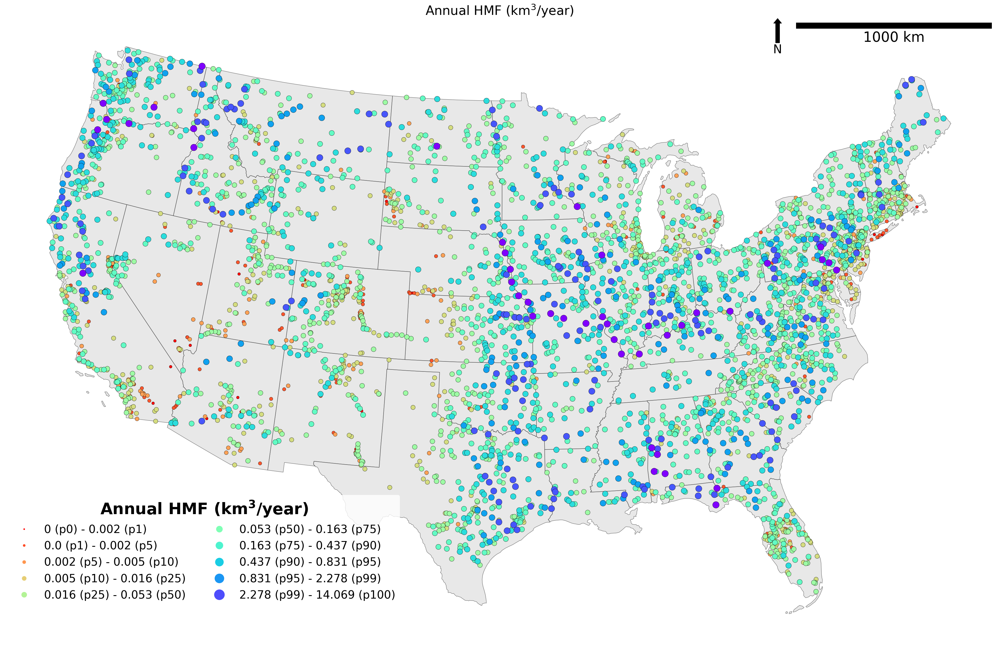

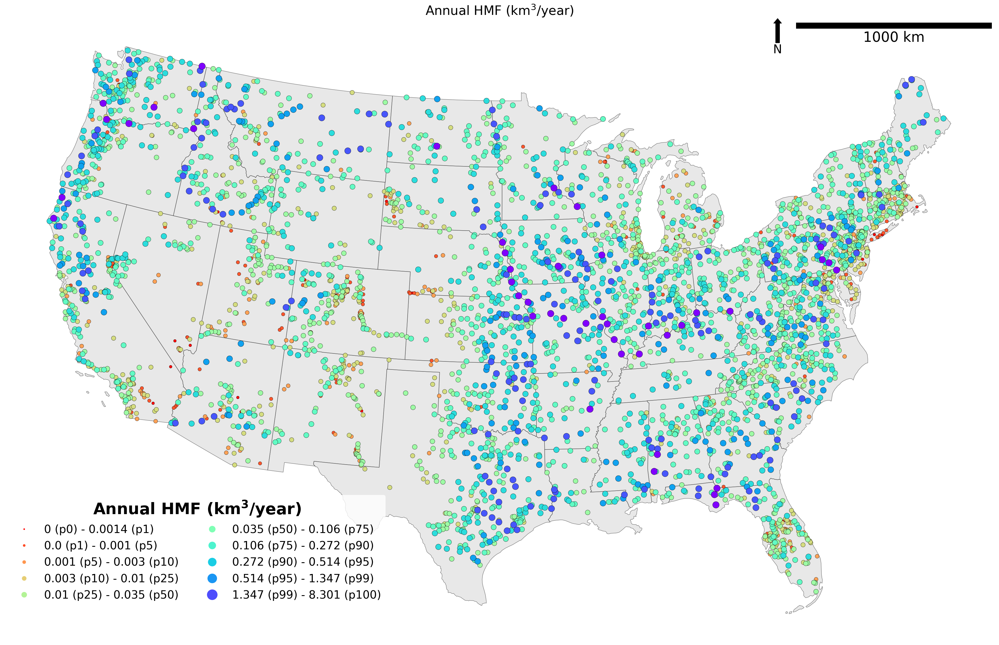

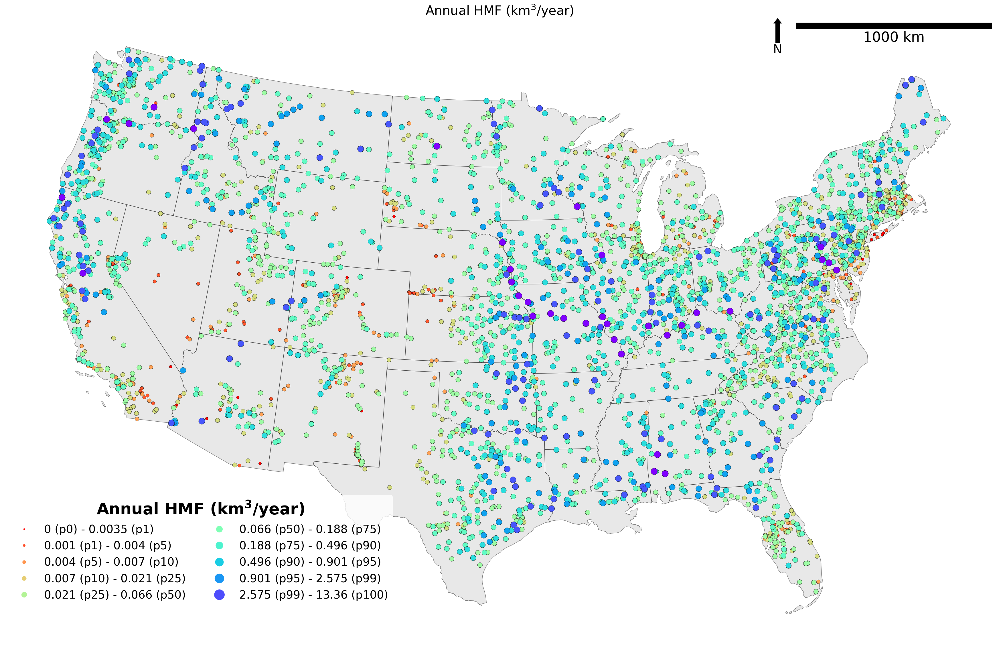

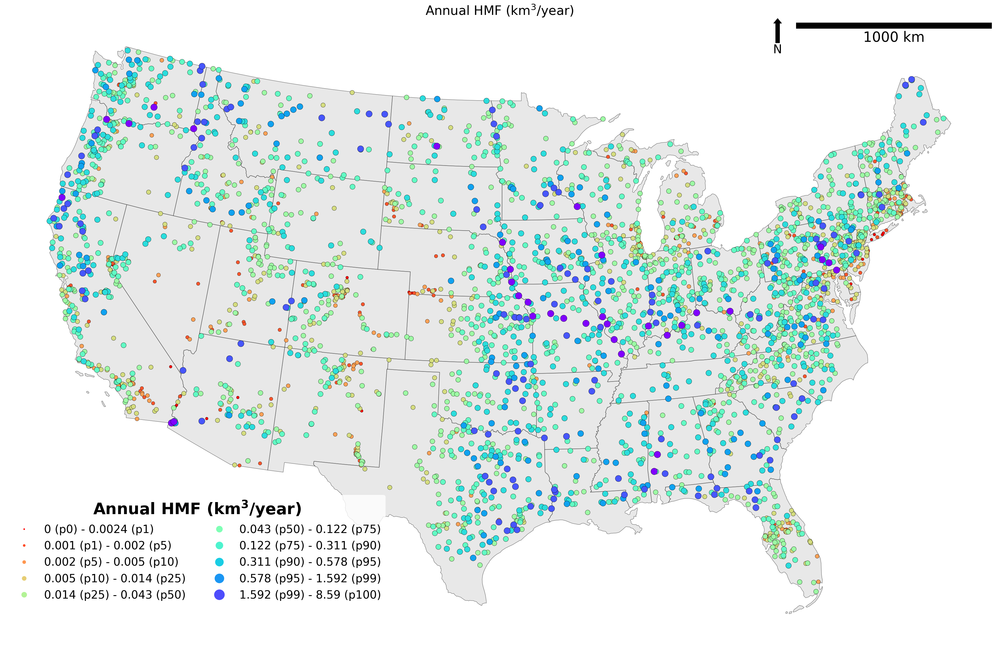

In [132]:
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.patches import FancyArrowPatch
from matplotlib.font_manager import FontProperties

def plot_hmf_metric(df, metric):    
    fig, ax = plt.subplots(figsize=(35, 35))

    #plt.title(f'{fn.FLOW_METRIC_UNITS[metric]}, ({date_range}-Year Record, {percentile}th Percentile)', fontsize=30)
    # legend_frmt = {
    #     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
    #     #"reverse": False,
    #     #"loc": "lower right",
    #     "facecolor": "white",
    #     #"alignment": 'center',
    #     "edgecolor": 'none',
    #     "framealpha": 0.80,
    #     'fontsize': 40,
    #     'title_fontsize': 40,
    #     'ncol':2
    # }

    lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
    #lower48 = lower48.to_crs(epsg=4269)
    lower48 = lower48.to_crs('ESRI:102003')
    lower48.plot(ax=ax, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
    
    # Aquifers
    # selected_aq_list_7 = ['High Plains aquifer',
    #             'Mississippi River Valley alluvial aquifer',
    #             'Central Valley aquifer system',
    #             'Floridan aquifer system',
    #             'Snake River Plain basaltic-rock aquifers',
    #             'Coastal lowlands aquifer system',
    #             'Northern Atlantic Coastal Plain aquifer system']
    
    # aq_10 = gpd.read_file('ShapeFiles/Aquifers_USGS_10/Aquifers_USGS_10.shp')
    # aq_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
    # aq_7 = aq_10[aq_10['AQ_NAME'].isin(selected_aq_list_7)]
    
    # if extent == 'aq25':
    #     aq_plot = aq_25

    # if extent == 'aq10':
    #     aq_plot = aq_10

    # if extent == 'aq7':
    #     aq_plot = aq_7
        
    # aq_plot = aq_plot.to_crs('ESRI:102003')
    # aq_plot.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)    

    geo_df = fn.convert_geometry(df)
    geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

    #classifier = mc.NaturalBreaks(geo_df[metric], k=8)
    #classifier = mc.Quantiles(geo_df[metric], k=5)
    classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99, 100])
    pct_list=[0, 1, 5, 10, 25, 50, 75, 90, 95, 99, 100]
    geo_df = geo_df.sort_values(metric, ascending=True)
    geo_df.crs = "epsg:4269"
    geo_df = geo_df.to_crs('ESRI:102003')

    def get_marker_size(value):
        # Define your logic to determine marker size based on the value
        if value < classifier.bins[0]:
            return 50
        elif value < classifier.bins[1]:
            return 75
        elif value < classifier.bins[2]:
            return 100
        elif value < classifier.bins[3]:
            return 125
        elif value < classifier.bins[4]:
            return 150
        elif value < classifier.bins[5]:
            return 175
        elif value < classifier.bins[6]:
            return 200
        elif value < classifier.bins[7]:
            return 225
        elif value < classifier.bins[8]:
            return 250         
        else:
            return 275

    # All gauges
    cmap_name ='rainbow_r'
    cmap = matplotlib.colormaps.get_cmap(cmap_name)
    bins = classifier.bins
    norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
    marker_list = [50/10, 75/10, 100/10, 125/10, 150/10, 175/10, 200/10, 225/10, 250/10, 275/10]

    geo_df.plot(ax=ax, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
                cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
                alpha=1.0, marker='o', 
                markersize=[get_marker_size(value) for value in geo_df[metric]],
                #markersize=150,
                edgecolor='black', linewidth=0.5)

    custom_labels = [f'0 (p{pct_list[0]}) - {round(bins[1], 4)} (p{pct_list[1]})'] + [
        f'{round(bins[i], 3)} (p{pct_list[i+1]}) - {round(bins[i+1], 3)} (p{pct_list[i+2]})' for i in range(len(bins) - 1)
    ]
    legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=marker_list[i], markerfacecolor=cmap(i / len(bins))) 
                       for i, label in enumerate(custom_labels)]

    # custom_labels_perc = [f'p{pct_list[i]}  - p{pct_list[i+1]}' for i in range(len(pct_list) - 1)]
    # legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=marker_list[i], markerfacecolor=cmap(i / len(bins))) 
    #                    for i, label in enumerate(custom_labels_perc)]
    
    ax.legend(
        handles=legend_elements,
        loc="lower left",
        bbox_to_anchor=(0, 0.05),
        title=f"{fn.FLOW_METRIC_UNITS[metric]}",
        facecolor="white",
        edgecolor="none",
        framealpha=0.80,
        fontsize=28,
        #title_fontsize=40,
        title_fontproperties=FontProperties(weight='bold', size=40),
        ncol=2,
        #labelspacing=1.01
    )

    # Inter-annual frequency
    # cmap ='rainbow_r'
    # bins = [20, 30, 40, 50, 60, 70, 80, 90, 95, 99, 100]
    # labels = ["20% - 30%", "30% - 40%", "40% - 50%", "50% - 60%", "60% - 70%", "70% - 80%", "80% - 90%", "90% - 95%", '95% - 99%', '99% - 100%']
    # geo_df['inter_annual%_bins'] = pd.cut(geo_df[metric], bins=bins, labels=labels, right=True)
    # geo_df.plot(ax=ax, column='inter_annual%_bins', 
    #             cmap=cmap, legend=True, legend_kwds=legend_frmt, 
    #             alpha=1.0, marker='o', 
    #             #markersize=[get_marker_size(value) for value in geo_df[metric]],
    #             markersize=150,
    #             edgecolor='black', linewidth=0.5)    
    
    ax.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

    # Add a scale bar (units in meters, adjust as necessary)
    scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
                       units="km", dimension="si-length", length_fraction=0.25,
                        scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
    ax.add_artist(scalebar)
    #scalebar.anchor = (1.5, 3.0)

    x, y, arrow_length = 0.78, 0.9995, 0.05
    ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
                arrowprops=dict(facecolor='black', width=10, headwidth=20),
                ha='center', va='center', fontsize=30,
                xycoords=ax.transAxes)
    #ax.add_patch(arrow)

    plt.axis("off")

    plt.tight_layout()
    plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/{type}_{extent}_{metric}_{date_range}_{percentile}.png', bbox_inches='tight')

    plt.show()

for date_range in date_ranges:
    for percentile in percentiles:
        df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
        df = df_wrong_index.reset_index()
        plot_hmf_metric(df, metric)

## Subplot of multiple HMF metrics

### Natural Breaks

In [86]:
bins

array([  9.8,  19. ,  31.9,  50. ,  73.3, 100. ])

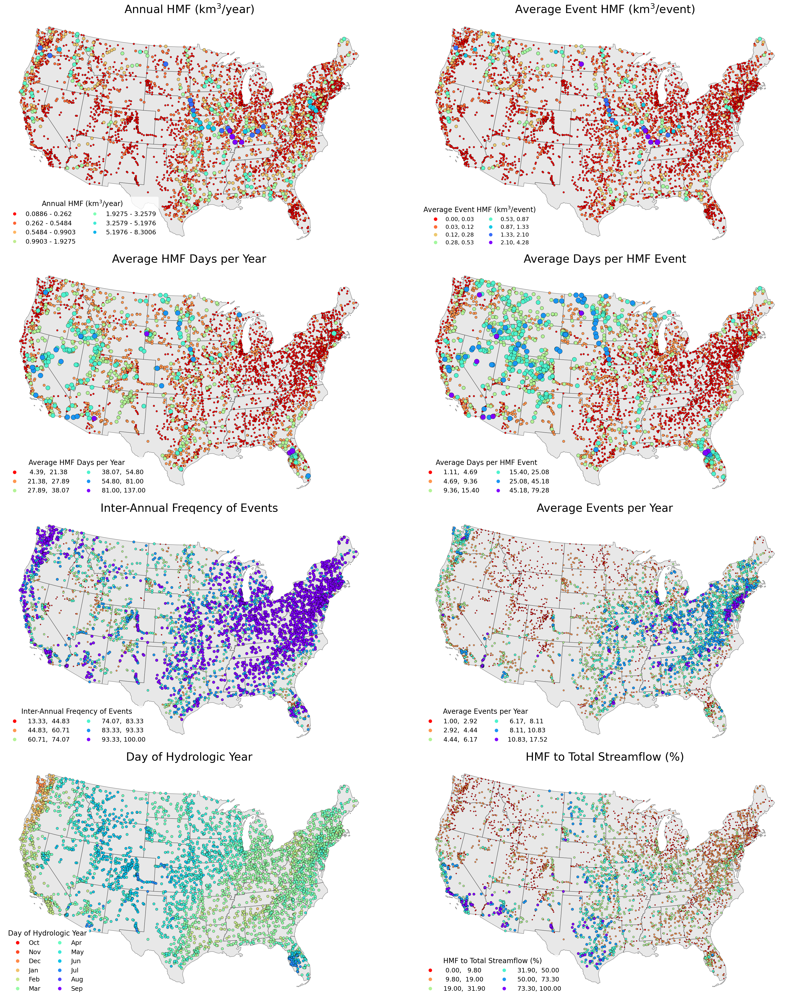

In [85]:
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.patches import FancyArrowPatch

percentile = '95'
date_range = '30'
#df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df_wrong_index = dfs_valid_update[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
extent = 'conus'

fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8)) = plt.subplots(nrows=4, ncols=2, figsize=(35, 40)) #figsize=(35, 35)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax1, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax2, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax3, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax4, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax5, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax6, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax7, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax8, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)

# lower48.plot(ax=ax1, edgecolor='black', facecolor='none', linewidth=1.0)
# lower48.plot(ax=ax2, edgecolor='black', facecolor='none', linewidth=1.0)
# lower48.plot(ax=ax3, edgecolor='black', facecolor='none', linewidth=1.0)
# lower48.plot(ax=ax4, edgecolor='black', facecolor='none', linewidth=1.0)
# lower48.plot(ax=ax5, edgecolor='black', facecolor='none', linewidth=1.0)
# lower48.plot(ax=ax6, edgecolor='black', facecolor='none', linewidth=1.0)

# Aquifers
# selected_aq_list_7 = ['High Plains aquifer',
#             'Mississippi River Valley alluvial aquifer',
#             'Central Valley aquifer system',
#             'Floridan aquifer system',
#             'Snake River Plain basaltic-rock aquifers',
#             'Coastal lowlands aquifer system',
#             'Northern Atlantic Coastal Plain aquifer system']

# aq_10 = gpd.read_file('ShapeFiles/Aquifers_USGS_10/Aquifers_USGS_10.shp')
# aq_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
# aq_7 = aq_10[aq_10['AQ_NAME'].isin(selected_aq_list_7)]

# if extent == 'aq25':
#     aq_plot = aq_25

# if extent == 'aq10':
#     aq_plot = aq_10

# if extent == 'aq7':
#     aq_plot = aq_7
    
# aq_plot = aq_plot.to_crs('ESRI:102003')
# aq_plot.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)    

######## Annual HMF ##########
metric = 'annual_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 75
    elif value < classifier.bins[3]:
        return 100
    elif value < classifier.bins[4]:
        return 125
    elif value < classifier.bins[5]:
        return 175
    elif value < classifier.bins[6]:
        return 200
    elif value < classifier.bins[7]:
        return 200
    else:
        return 250

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)

geo_df.plot(ax=ax1, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5)

custom_labels = [f'{round(bins[i], 4)} - {round(bins[i+1], 4)}' for i in range(len(bins)-1)]
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=10, markerfacecolor=cmap(i / len(bins))) 
                   for i, label in enumerate(custom_labels)]

ax1.legend(
    handles=legend_elements,
    loc="lower left",
    bbox_to_anchor=(0, 0),
    title=f"{fn.FLOW_METRIC_UNITS[metric]}",
    facecolor="white",
    edgecolor="none",
    framealpha=0.80,
    fontsize=18,
    title_fontsize=20,
    ncol=2
)

ax1.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

# legend_frmt = {
#     #"title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 20,
#     #'title_fontsize': 40
# }

# legend = ax1.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
#plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax1.transAxes)
# #ax.add_patch(arrow)

######## Event HMF ##########
metric = 'event_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 75
    elif value < classifier.bins[3]:
        return 100
    elif value < classifier.bins[5]:
        return 125
    elif value < classifier.bins[6]:
        return 175
    elif value < classifier.bins[7]:
        return 200 
    else:
        return 250

cmap ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax2, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 16,
        'title_fontsize': 20,
        'ncol': 2
    })

ax2.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

# legend = ax2.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax2.transAxes)
# #ax.add_patch(arrow)

######## Annual duration ##########
metric = 'annual_duration'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 100
    elif value < classifier.bins[3]:
        return 150
    elif value < classifier.bins[5]:
        return 200 
    else:
        return 250

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax3, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax3.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

# legend = ax3.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax3.transAxes)
# #ax.add_patch(arrow)

######## Event duration ##########
metric = 'event_duration'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 100
    elif value < classifier.bins[3]:
        return 150
    elif value < classifier.bins[5]:
        return 200 
    else:
        return 250

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax4, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax4.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 12,
#     'title_fontsize': 12
# }

# legend = ax4.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
#plt.setp(legend.get_title(), fontweight='bold', fontsize=12)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax4.transAxes)
# #ax.add_patch(arrow)

######## Inter-annual ##########
metric = 'inter_annual%'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50  
    else:
        return 60

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax5, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax5.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

# legend = ax5.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax5.transAxes)
# #ax.add_patch(arrow)

######## Intra-annual ##########
metric = 'intra_annual'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50  
    else:
        return 60

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax6, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax6.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

# legend = ax6.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax6.transAxes)
# #ax.add_patch(arrow)

######## Timing ##########
metric = 'timing'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

# Define the ranges for each month
month_bins = {
    "Oct": range(1, 32),
    "Nov": range(32, 62),
    "Dec": range(62, 93),
    "Jan": range(93, 124),
    "Feb": range(124, 153),
    "Mar": range(153, 184),
    "Apr": range(184, 214),
    "May": range(214, 245),
    "Jun": range(245, 275),
    "Jul": range(275, 306),
    "Aug": range(306, 337),
    "Sep": range(337, 366)
}

# Convert the numbers into months
def determine_month(value):
    value_int = int(round(value))
    for month, days in month_bins.items():
        if value_int in days:
            return month
    return None  # Return None if out of range (should not happen with valid data)

geo_df['month'] = geo_df[metric].apply(determine_month)

# Convert 'month' to a categorical type with the correct order from month_bins
month_order = list(month_bins.keys())
geo_df['month'] = pd.Categorical(geo_df['month'], categories=month_order, ordered=True)

# Define a color map to match the order of months
cmap = plt.get_cmap('rainbow_r', len(month_order))  # Create a colormap with as many colors as there are months
colors = [cmap(i) for i in range(len(month_order))]  # Generate colors based on the colormap

# Create a custom colormap based on the month order
norm = mcolors.BoundaryNorm(boundaries=range(len(month_order) + 1), ncolors=len(month_order))
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)

geo_df.plot(ax=ax7, column='month', #scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=50,
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        "ncol": 2
    })

ax7.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

######## Percent HMF ##########
metric = 'pct_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
#classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50  
    else:
        return 60

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax8, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })
ax8.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

ax1.axis("off")
ax2.axis("off")
ax3.axis("off")
ax4.axis("off")
ax5.axis("off")
ax6.axis("off")
ax7.axis("off")
ax8.axis("off")

#plt.subplots_adjust(left=0.5, right=0.9, bottom=0.5, top=0.9, wspace=0.01, hspace=0.00000005)
plt.tight_layout()

plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/naturalbreaks_{extent}_all_metrics_pct_hmf_{date_range}_{percentile}.png', bbox_inches='tight')

plt.show()

### Quantiles

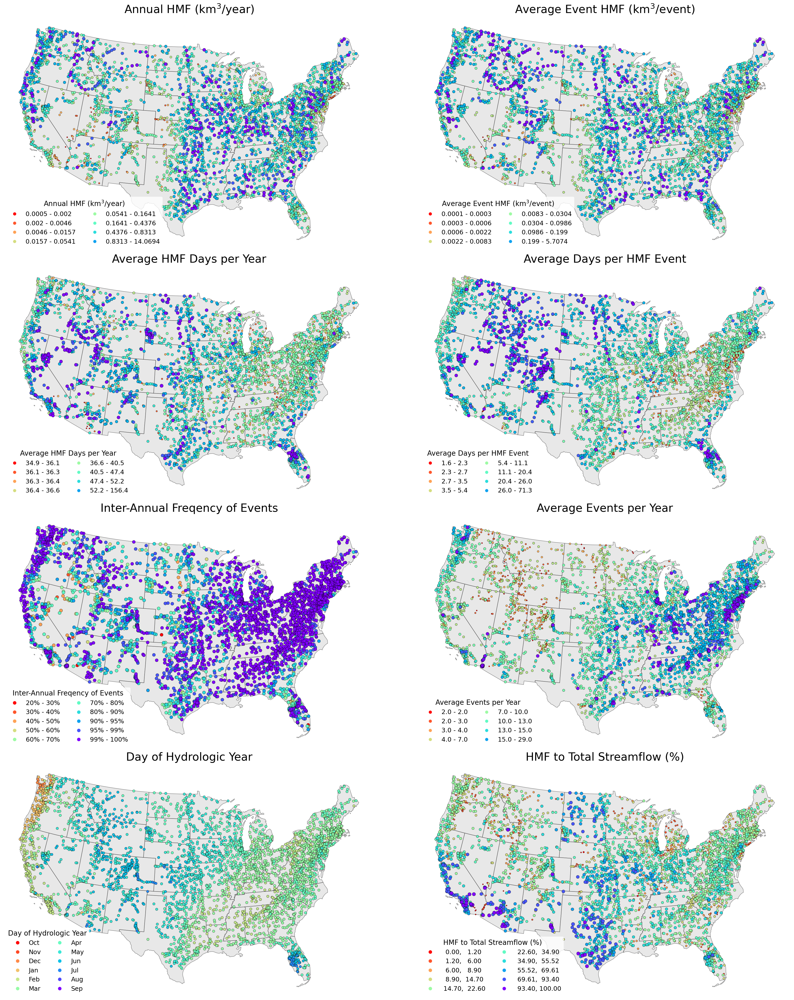

In [82]:
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.patches import FancyArrowPatch
from matplotlib.lines import Line2D

percentile = '90'
date_range = '30'
#df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df_wrong_index = dfs_valid_update[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
extent = 'conus'

fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8)) = plt.subplots(nrows=4, ncols=2, figsize=(35, 40)) #figsize=(35, 35)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax1, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax2, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax3, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax4, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax5, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax6, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax7, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax8, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)

# Aquifers
# selected_aq_list_7 = ['High Plains aquifer',
#             'Mississippi River Valley alluvial aquifer',
#             'Central Valley aquifer system',
#             'Floridan aquifer system',
#             'Snake River Plain basaltic-rock aquifers',
#             'Coastal lowlands aquifer system',
#             'Northern Atlantic Coastal Plain aquifer system']

# aq_10 = gpd.read_file('ShapeFiles/Aquifers_USGS_10/Aquifers_USGS_10.shp')
# aq_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
# aq_7 = aq_10[aq_10['AQ_NAME'].isin(selected_aq_list_7)]

# if extent == 'aq25':
#     aq_plot = aq_25

# if extent == 'aq10':
#     aq_plot = aq_10

# if extent == 'aq7':
#     aq_plot = aq_7
    
# aq_plot = aq_plot.to_crs('ESRI:102003')
# aq_plot.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)    

######## Annual HMF ##########
metric = 'annual_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=8)
#classifier = mc.Quantiles(geo_df[metric], k=10)
classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 100])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50
    elif value < classifier.bins[6]:
        return 60
    elif value < classifier.bins[7]:
        return 70
    elif value < classifier.bins[8]:
        return 80   
    else:
        return 95

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax1, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5)

custom_labels = [f'{round(bins[i], 4)} - {round(bins[i+1], 4)}' for i in range(len(bins)-1)]
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=10, markerfacecolor=cmap(i / len(bins))) 
                   for i, label in enumerate(custom_labels)]

ax1.legend(
    handles=legend_elements,
    loc="lower left",
    bbox_to_anchor=(0, 0),
    title=f"{fn.FLOW_METRIC_UNITS[metric]}",
    facecolor="white",
    edgecolor="none",
    framealpha=0.80,
    fontsize=18,
    title_fontsize=20,
    ncol=2
)

ax1.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

# legend = ax1.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
#plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax1.transAxes)
# #ax.add_patch(arrow)

######## Event HMF ##########
metric = 'event_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=8)
#classifier = mc.Quantiles(geo_df[metric], k=10)
classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95,100])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50
    elif value < classifier.bins[6]:
        return 60
    elif value < classifier.bins[7]:
        return 70
    elif value < classifier.bins[8]:
        return 80   
    else:
        return 95

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax2, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5)

custom_labels = [f'{round(bins[i], 4)} - {round(bins[i+1], 4)}' for i in range(len(bins)-1)]
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=10, markerfacecolor=cmap(i / len(bins))) 
                   for i, label in enumerate(custom_labels)]

ax2.legend(
    handles=legend_elements,
    loc="lower left",
    bbox_to_anchor=(0, 0),
    title=f"{fn.FLOW_METRIC_UNITS[metric]}",
    facecolor="white",
    edgecolor="none",
    framealpha=0.80,
    fontsize=18,
    title_fontsize=20,
    ncol=2
)

ax2.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

# legend = ax2.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax2.transAxes)
# #ax.add_patch(arrow)

######## Annual duration ##########
metric = 'annual_duration'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 100])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50
    elif value < classifier.bins[6]:
        return 60
    elif value < classifier.bins[7]:
        return 70
    elif value < classifier.bins[8]:
        return 80   
    else:
        return 95

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax3, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5)

custom_labels = [f'{round(bins[i], 1)} - {round(bins[i+1], 1)}' for i in range(len(bins)-1)]
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=10, markerfacecolor=cmap(i / len(bins))) 
                   for i, label in enumerate(custom_labels)]

ax3.legend(
    handles=legend_elements,
    loc="lower left",
    bbox_to_anchor=(0, 0),
    title=f"{fn.FLOW_METRIC_UNITS[metric]}",
    facecolor="white",
    edgecolor="none",
    framealpha=0.80,
    fontsize=18,
    title_fontsize=20,
    ncol=2
)

ax3.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)


# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax3.transAxes)
# #ax.add_patch(arrow)

######## Event duration ##########
metric = 'event_duration'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 100])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50
    elif value < classifier.bins[6]:
        return 60
    elif value < classifier.bins[7]:
        return 70
    elif value < classifier.bins[8]:
        return 80   
    else:
        return 95

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax4, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5)

custom_labels = [f'{round(bins[i], 1)} - {round(bins[i+1], 1)}' for i in range(len(bins)-1)]
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=10, markerfacecolor=cmap(i / len(bins))) 
                   for i, label in enumerate(custom_labels)]

ax4.legend(
    handles=legend_elements,
    loc="lower left",
    bbox_to_anchor=(0, 0),
    title=f"{fn.FLOW_METRIC_UNITS[metric]}",
    facecolor="white",
    edgecolor="none",
    framealpha=0.80,
    fontsize=18,
    title_fontsize=20,
    ncol=2
)

ax4.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax4.transAxes)
# #ax.add_patch(arrow)

######## Inter-annual ##########
metric = 'inter_annual%'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=5)
#classifier = mc.Percentiles(geo_df[metric], pct=[5, 25, 50, 75, 95])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 10
#     elif value < classifier.bins[1]:
#         return 20
#     elif value < classifier.bins[2]:
#         return 30
#     elif value < classifier.bins[3]:
#         return 40
#     elif value < classifier.bins[4]:
#         return 50
#     elif value < classifier.bins[5]:
#         return 60
#     elif value < classifier.bins[6]:
#         return 70
#     elif value < classifier.bins[7]:
#         return 80
#     elif value < classifier.bins[8]:
#         return 90
#     else:
#         return 95

# cmap ='rainbow_r'
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax5, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             #markersize=[get_marker_size(value) for value in geo_df[metric]],
#             markersize=60, 
#             edgecolor='black', linewidth=0.5,
#             legend_kwds={
#         "loc": "lower left",  # Set the legend location to lower left
#         "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
#         "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#         "facecolor": "white",
#         "edgecolor": "none",
#         "framealpha": 0.80,
#         'fontsize': 18,
#         'title_fontsize': 20,
#         'ncol': 2
#     })

cmap ='rainbow_r'
bins = [20, 30, 40, 50, 60, 70, 80, 90, 95, 99, 100]
labels = ["20% - 30%", "30% - 40%", "40% - 50%", "50% - 60%", "60% - 70%", "70% - 80%", "80% - 90%", "90% - 95%", '95% - 99%', '99% - 100%']
geo_df['inter_annual%_bins'] = pd.cut(geo_df[metric], bins=bins, labels=labels, right=True)
geo_df.plot(ax=ax5, column='inter_annual%_bins', 
            cmap=cmap, legend=True, 
            alpha=1.0, marker='o', 
            #markersize=[get_marker_size(value) for value in geo_df[metric]],
            markersize=80,
            edgecolor='black', linewidth=0.5,
           legend_kwds={
            "loc": "lower left",  # Set the legend location to lower left
            "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
            "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
            "facecolor": "white",
            "edgecolor": "none",
            "framealpha": 0.80,
            'fontsize': 18,
            'title_fontsize': 20,
            'ncol': 2
        })    

ax5.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

# legend = ax5.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax5.transAxes)
# #ax.add_patch(arrow)

######## Intra-annual ##########
metric = 'intra_annual'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 100])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50
    elif value < classifier.bins[6]:
        return 60
    elif value < classifier.bins[7]:
        return 70
    elif value < classifier.bins[8]:
        return 80   
    else:
        return 95

cmap_name ='rainbow_r'
cmap = matplotlib.colormaps.get_cmap(cmap_name)
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax6, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5)

custom_labels = [f'{round(bins[i], 0)} - {round(bins[i+1], 0)}' for i in range(len(bins)-1)]
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label, markersize=10, markerfacecolor=cmap(i / len(bins))) 
                   for i, label in enumerate(custom_labels)]

ax6.legend(
    handles=legend_elements,
    loc="lower left",
    bbox_to_anchor=(0, 0),
    title=f"{fn.FLOW_METRIC_UNITS[metric]}",
    facecolor="white",
    edgecolor="none",
    framealpha=0.80,
    fontsize=18,
    title_fontsize=20,
    ncol=2
)

ax6.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax6.transAxes)
# #ax.add_patch(arrow)

######## Timing ##########
metric = 'timing'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=8)
#classifier = mc.Quantiles(geo_df[metric], k=10)
classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

# Define the ranges for each month
month_bins = {
    "Oct": range(1, 32),
    "Nov": range(32, 62),
    "Dec": range(62, 93),
    "Jan": range(93, 124),
    "Feb": range(124, 153),
    "Mar": range(153, 184),
    "Apr": range(184, 214),
    "May": range(214, 245),
    "Jun": range(245, 275),
    "Jul": range(275, 306),
    "Aug": range(306, 337),
    "Sep": range(337, 366)
}

# Convert the numbers into months
def determine_month(value):
    value_int = int(round(value))
    for month, days in month_bins.items():
        if value_int in days:
            return month
    return None  # Return None if out of range (should not happen with valid data)

geo_df['month'] = geo_df[metric].apply(determine_month)

# Convert 'month' to a categorical type with the correct order from month_bins
month_order = list(month_bins.keys())
geo_df['month'] = pd.Categorical(geo_df['month'], categories=month_order, ordered=True)

# Define a color map to match the order of months
cmap = plt.get_cmap('rainbow_r', len(month_order))  # Create a colormap with as many colors as there are months
colors = [cmap(i) for i in range(len(month_order))]  # Generate colors based on the colormap

# Create a custom colormap based on the month order
norm = mcolors.BoundaryNorm(boundaries=range(len(month_order) + 1), ncolors=len(month_order))
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)

geo_df.plot(ax=ax7, column='month', #scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=50,
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        "ncol": 2
    })

ax7.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

######## Percent HMF ##########
metric = 'pct_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=6)
#classifier = mc.Quantiles(geo_df[metric], k=10)
classifier = mc.Percentiles(geo_df[metric], pct=[1, 5, 10, 25, 50, 75, 90, 95, 99])
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 40
    elif value < classifier.bins[5]:
        return 50
    elif value < classifier.bins[6]:
        return 60
    elif value < classifier.bins[7]:
        return 70
    elif value < classifier.bins[8]:
        return 80   
    else:
        return 95

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax8, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })
ax8.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

ax1.axis("off")
ax2.axis("off")
ax3.axis("off")
ax4.axis("off")
ax5.axis("off")
ax6.axis("off")
ax7.axis("off")
ax8.axis("off")

#plt.subplots_adjust(left=0.5, right=0.9, bottom=0.5, top=0.9, wspace=0.01, hspace=0.00000005)
plt.tight_layout()

plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/percentiles_{extent}_all_metrics_pct_hmf_{date_range}_{percentile}.png', bbox_inches='tight')

plt.show()

### Outliers with natural breaks

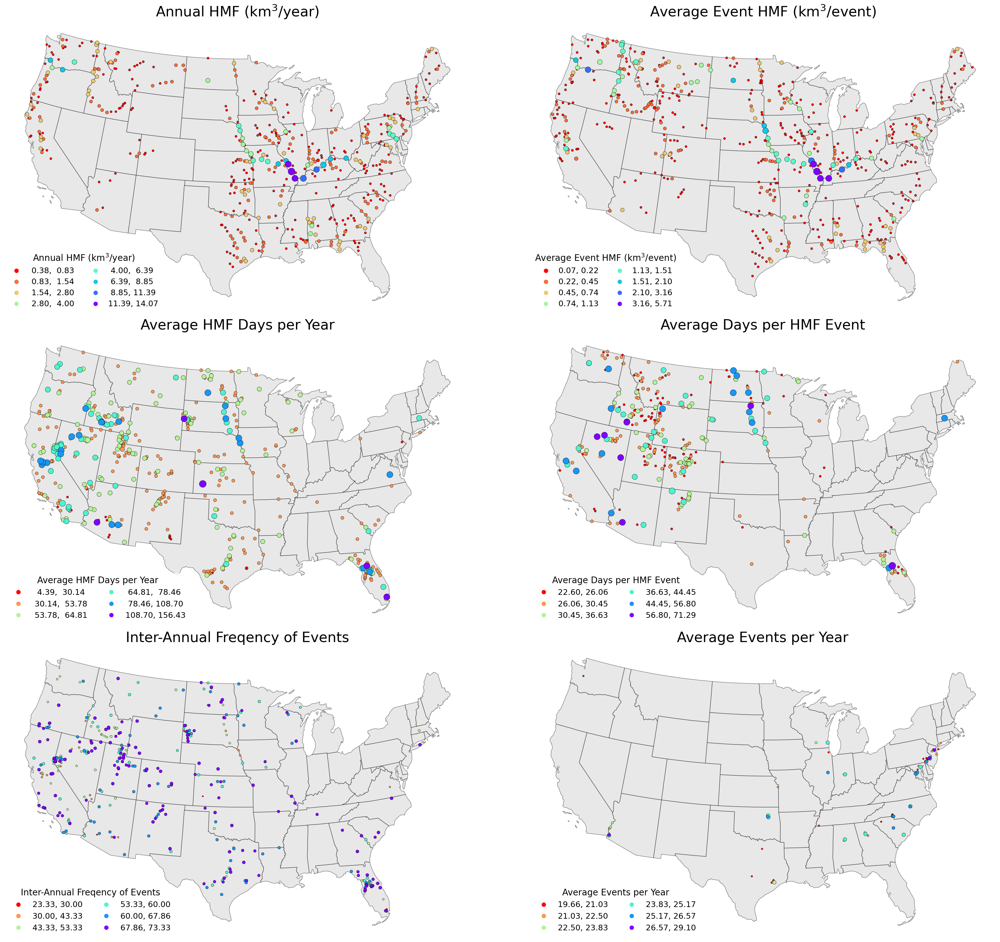

In [239]:
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.patches import FancyArrowPatch

percentile = '90'
date_range = '30'
df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
extent = 'conus'

fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(nrows=3, ncols=2, figsize=(35, 30)) #figsize=(35, 35)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax1, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax2, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax3, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax4, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax5, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax6, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)

# Aquifers
# selected_aq_list_7 = ['High Plains aquifer',
#             'Mississippi River Valley alluvial aquifer',
#             'Central Valley aquifer system',
#             'Floridan aquifer system',
#             'Snake River Plain basaltic-rock aquifers',
#             'Coastal lowlands aquifer system',
#             'Northern Atlantic Coastal Plain aquifer system']

# aq_10 = gpd.read_file('ShapeFiles/Aquifers_USGS_10/Aquifers_USGS_10.shp')
# aq_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
# aq_7 = aq_10[aq_10['AQ_NAME'].isin(selected_aq_list_7)]

# if extent == 'aq25':
#     aq_plot = aq_25

# if extent == 'aq10':
#     aq_plot = aq_10

# if extent == 'aq7':
#     aq_plot = aq_7
    
# aq_plot = aq_plot.to_crs('ESRI:102003')
# aq_plot.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)    

######## Annual HMF ##########
metric = 'annual_hmf'

df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()
df = pd.concat([upper_outliers, lower_outliers], ignore_index=True)

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 75
    elif value < classifier.bins[3]:
        return 100
    elif value < classifier.bins[5]:
        return 125
    elif value < classifier.bins[6]:
        return 175
    elif value < classifier.bins[7]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax1, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 16,
        'title_fontsize': 20,
        'ncol': 2
    })

ax1.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

legend = ax1.get_legend()
for text in legend.get_texts():
    text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax1.transAxes)
# #ax.add_patch(arrow)

######## Event HMF ##########
metric = 'event_hmf'

df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()
df = pd.concat([upper_outliers, lower_outliers], ignore_index=True)

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 75
    elif value < classifier.bins[3]:
        return 100
    elif value < classifier.bins[5]:
        return 125
    elif value < classifier.bins[6]:
        return 175
    elif value < classifier.bins[7]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax2, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 16,
        'title_fontsize': 20,
        'ncol': 2
    })

ax2.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

legend = ax2.get_legend()
for text in legend.get_texts():
    text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax2.transAxes)
# #ax.add_patch(arrow)

######## Annual duration ##########
metric = 'annual_duration'

df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()
df = pd.concat([upper_outliers, lower_outliers], ignore_index=True)

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 100
    elif value < classifier.bins[3]:
        return 150
    elif value < classifier.bins[5]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax3, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax3.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

legend = ax3.get_legend()
for text in legend.get_texts():
    text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax3.transAxes)
# #ax.add_patch(arrow)

######## Event duration ##########
metric = 'event_duration'

df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()
df = pd.concat([upper_outliers, lower_outliers], ignore_index=True)

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 25
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 100
    elif value < classifier.bins[3]:
        return 150
    elif value < classifier.bins[5]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax4, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax4.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 12,
#     'title_fontsize': 12
# }

legend = ax4.get_legend()
for text in legend.get_texts():
    text.set_fontsize(18)  # Change the font size as needed
#plt.setp(legend.get_title(), fontweight='bold', fontsize=12)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax4.transAxes)
# #ax.add_patch(arrow)

######## Inter-annual ##########
metric = 'inter_annual%'

df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()
df = pd.concat([upper_outliers, lower_outliers], ignore_index=True)

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 10
    elif value < classifier.bins[1]:
        return 15
    elif value < classifier.bins[2]:
        return 20
    elif value < classifier.bins[3]:
        return 30
    elif value < classifier.bins[5]:
        return 40
    else:
        return 50

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax5, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax5.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

legend = ax5.get_legend()
for text in legend.get_texts():
    text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax5.transAxes)
# #ax.add_patch(arrow)

######## Intra-annual ##########
metric = 'intra_annual'

df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()
df = pd.concat([upper_outliers, lower_outliers], ignore_index=True)

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=6)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 15
    elif value < classifier.bins[1]:
        return 20
    elif value < classifier.bins[2]:
        return 30
    elif value < classifier.bins[3]:
        return 70
    elif value < classifier.bins[5]:
        return 50
    else:
        return 60

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax6, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
           legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax6.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 40,
#     'title_fontsize': 40
# }

# legend = ax6.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(18)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax6.transAxes)
# #ax.add_patch(arrow)


ax1.axis("off")
ax2.axis("off")
ax3.axis("off")
ax4.axis("off")
ax5.axis("off")
ax6.axis("off")

#plt.subplots_adjust(left=0.5, right=0.9, bottom=0.5, top=0.9, wspace=0.01, hspace=0.00000005)
plt.tight_layout()

plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/{extent}_outliers_{date_range}_{percentile}.png', bbox_inches='tight')

plt.show()

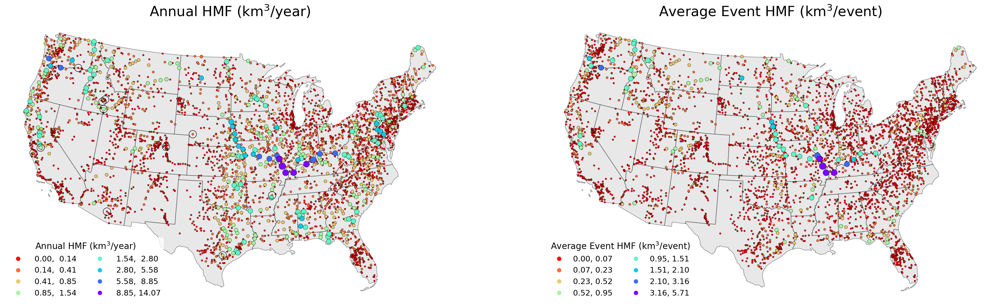

In [272]:
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.patches import FancyArrowPatch

percentile = '90'
date_range = '30'
df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
extent = 'conus'

fig, ((ax1, ax2)) = plt.subplots(nrows=1, ncols=2, figsize=(35, 10)) #figsize=(35, 35)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax1, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax2, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)

# Aquifers
# selected_aq_list_7 = ['High Plains aquifer',
#             'Mississippi River Valley alluvial aquifer',
#             'Central Valley aquifer system',
#             'Floridan aquifer system',
#             'Snake River Plain basaltic-rock aquifers',
#             'Coastal lowlands aquifer system',
#             'Northern Atlantic Coastal Plain aquifer system']

# aq_10 = gpd.read_file('ShapeFiles/Aquifers_USGS_10/Aquifers_USGS_10.shp')
# aq_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
# aq_7 = aq_10[aq_10['AQ_NAME'].isin(selected_aq_list_7)]

# if extent == 'aq25':
#     aq_plot = aq_25

# if extent == 'aq10':
#     aq_plot = aq_10

# if extent == 'aq7':
#     aq_plot = aq_7
    
# aq_plot = aq_plot.to_crs('ESRI:102003')
# aq_plot.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)    

######## Annual HMF ##########
metric = 'annual_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 15
    elif value < classifier.bins[1]:
        return 25
    elif value < classifier.bins[2]:
        return 50
    elif value < classifier.bins[3]:
        return 75
    elif value < classifier.bins[5]:
        return 125
    elif value < classifier.bins[6]:
        return 150
    elif value < classifier.bins[7]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax1, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })

ax1.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)

geo_df = fn.convert_geometry(df_mar)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')
geo_df.plot(ax=ax1, edgecolor='black', color='none', label=f'MAR Gages)', markersize=300, marker='o', alpha=1.0, legend=True)

# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 15,
#     'title_fontsize': 15
# }

# legend = ax1.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(35)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax1.transAxes)
# #ax.add_patch(arrow)

######## Event HMF ##########
metric = 'event_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 15
    elif value < classifier.bins[1]:
        return 25
    elif value < classifier.bins[2]:
        return 50
    elif value < classifier.bins[3]:
        return 75
    elif value < classifier.bins[5]:
        return 125
    elif value < classifier.bins[6]:
        return 150
    elif value < classifier.bins[7]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
#norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax2, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        'ncol': 2
    })
            

ax2.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 15,
#     'title_fontsize': 15
# }

# legend = ax2.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(35)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax2.transAxes)
# #ax.add_patch(arrow)

# ######## Annual duration ##########
# metric = 'annual_duration'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 15
#     elif value < classifier.bins[1]:
#         return 30
#     elif value < classifier.bins[2]:
#         return 45
#     elif value < classifier.bins[3]:
#         return 60
#     elif value < classifier.bins[5]:
#         return 75
#     else:
#         return 90

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax3, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax3.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# # legend_frmt = {
# #     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
# #     #"reverse": False,
# #     #"loc": "lower right",
# #     "facecolor": "white",
# #     #"alignment": 'center',
# #     "edgecolor": 'none',
# #     "framealpha": 0.80,
# #     'fontsize': 40,
# #     'title_fontsize': 40
# # }

# # legend = ax3.get_legend()
# # for text in legend.get_texts():
# #     text.set_fontsize(35)  # Change the font size as needed
# # plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax3.transAxes)
# # #ax.add_patch(arrow)

# ######## Event duration ##########
# metric = 'event_duration'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 15
#     elif value < classifier.bins[1]:
#         return 30
#     elif value < classifier.bins[2]:
#         return 45
#     elif value < classifier.bins[3]:
#         return 60
#     elif value < classifier.bins[5]:
#         return 75
#     else:
#         return 90

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax4, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax4.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 12,
#     'title_fontsize': 12
# }

# legend = ax4.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(8)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=12)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax4.transAxes)
# # #ax.add_patch(arrow)

# ######## Inter-annual ##########
# metric = 'inter_annual%'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 10
#     elif value < classifier.bins[1]:
#         return 10
#     elif value < classifier.bins[2]:
#         return 10
#     elif value < classifier.bins[3]:
#         return 10
#     elif value < classifier.bins[5]:
#         return 10
#     else:
#         return 10

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax5, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax5.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# # legend_frmt = {
# #     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
# #     #"reverse": False,
# #     #"loc": "lower right",
# #     "facecolor": "white",
# #     #"alignment": 'center',
# #     "edgecolor": 'none',
# #     "framealpha": 0.80,
# #     'fontsize': 40,
# #     'title_fontsize': 40
# # }

# # legend = ax5.get_legend()
# # for text in legend.get_texts():
# #     text.set_fontsize(35)  # Change the font size as needed
# # plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax5.transAxes)
# # #ax.add_patch(arrow)

# ######## Intra-annual ##########
# metric = 'intra_annual'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 10
#     elif value < classifier.bins[1]:
#         return 15
#     elif value < classifier.bins[2]:
#         return 20
#     elif value < classifier.bins[3]:
#         return 25
#     elif value < classifier.bins[5]:
#         return 30
#     else:
#         return 35

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax6, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax6.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# # legend_frmt = {
# #     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
# #     #"reverse": False,
# #     #"loc": "lower right",
# #     "facecolor": "white",
# #     #"alignment": 'center',
# #     "edgecolor": 'none',
# #     "framealpha": 0.80,
# #     'fontsize': 40,
# #     'title_fontsize': 40
# # }

# # legend = ax6.get_legend()
# # for text in legend.get_texts():
# #     text.set_fontsize(35)  # Change the font size as needed
# # plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax6.transAxes)
# # #ax.add_patch(arrow)


ax1.axis("off")
ax2.axis("off")

#plt.subplots_adjust(left=0.5, right=0.9, bottom=0.5, top=0.9, wspace=0.01, hspace=0.00000005)
plt.tight_layout()

plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/{extent}_vol_compare_{date_range}_{percentile}.png', bbox_inches='tight')

plt.show()

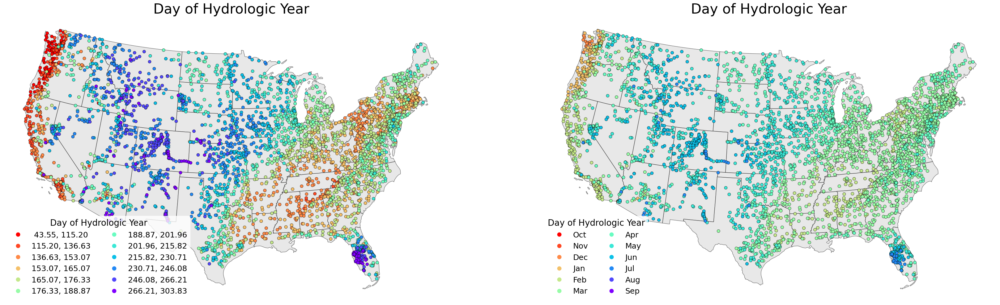

In [234]:
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.patches import FancyArrowPatch

percentile = '90'
date_range = '30'
df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
extent = 'conus'

fig, ((ax1, ax2)) = plt.subplots(nrows=1, ncols=2, figsize=(35, 10)) #figsize=(35, 35)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax1, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax2, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)

# Aquifers
# selected_aq_list_7 = ['High Plains aquifer',
#             'Mississippi River Valley alluvial aquifer',
#             'Central Valley aquifer system',
#             'Floridan aquifer system',
#             'Snake River Plain basaltic-rock aquifers',
#             'Coastal lowlands aquifer system',
#             'Northern Atlantic Coastal Plain aquifer system']

# aq_10 = gpd.read_file('ShapeFiles/Aquifers_USGS_10/Aquifers_USGS_10.shp')
# aq_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
# aq_7 = aq_10[aq_10['AQ_NAME'].isin(selected_aq_list_7)]

# if extent == 'aq25':
#     aq_plot = aq_25

# if extent == 'aq10':
#     aq_plot = aq_10

# if extent == 'aq7':
#     aq_plot = aq_7
    
# aq_plot = aq_plot.to_crs('ESRI:102003')
# aq_plot.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)    

######## Timing ##########
metric = 'timing'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=12)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 50
    elif value < classifier.bins[1]:
        return 50
    elif value < classifier.bins[2]:
        return 50
    elif value < classifier.bins[3]:
        return 50
    elif value < classifier.bins[5]:
        return 50
    elif value < classifier.bins[6]:
        return 50
    elif value < classifier.bins[7]:
        return 50
    elif value < classifier.bins[8]:
        return 50
    elif value < classifier.bins[9]:
        return 50
    elif value < classifier.bins[10]:
        return 50
    elif value < classifier.bins[11]:
        return 50
    else:
        return 50

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax1, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
                "ncol": 2
    })

ax1.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 15,
#     'title_fontsize': 15
# }

# legend = ax1.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(35)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax1.transAxes)
# #ax.add_patch(arrow)

######## Timing ##########
metric = 'timing'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

#classifier = mc.NaturalBreaks(geo_df[metric], k=8)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

# Define the ranges for each month
month_bins = {
    "Oct": range(1, 32),
    "Nov": range(32, 62),
    "Dec": range(62, 93),
    "Jan": range(93, 124),
    "Feb": range(124, 153),
    "Mar": range(153, 184),
    "Apr": range(184, 214),
    "May": range(214, 245),
    "Jun": range(245, 275),
    "Jul": range(275, 306),
    "Aug": range(306, 337),
    "Sep": range(337, 366)
}

# Convert the numbers into months
def determine_month(value):
    value_int = int(round(value))
    for month, days in month_bins.items():
        if value_int in days:
            return month
    return None  # Return None if out of range (should not happen with valid data)

geo_df['month'] = geo_df[metric].apply(determine_month)

# Convert 'month' to a categorical type with the correct order from month_bins
month_order = list(month_bins.keys())
geo_df['month'] = pd.Categorical(geo_df['month'], categories=month_order, ordered=True)

# Define a color map to match the order of months
cmap = plt.get_cmap('rainbow_r', len(month_order))  # Create a colormap with as many colors as there are months
colors = [cmap(i) for i in range(len(month_order))]  # Generate colors based on the colormap

# Create a custom colormap based on the month order
norm = mcolors.BoundaryNorm(boundaries=range(len(month_order) + 1), ncolors=len(month_order))
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 15
#     elif value < classifier.bins[1]:
#         return 25
#     elif value < classifier.bins[2]:
#         return 50
#     elif value < classifier.bins[3]:
#         return 75
#     elif value < classifier.bins[5]:
#         return 125
#     elif value < classifier.bins[6]:
#         return 150
#     elif value < classifier.bins[7]:
#         return 200
#     else:
#         return 250

#cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
#norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax2, column='month', #scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=50,
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20,
        "ncol": 2
    })

ax2.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 15,
#     'title_fontsize': 15
# }

# legend = ax1.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(35)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax1.transAxes)
# #ax.add_patch(arrow)


ax1.axis("off")
ax2.axis("off")

#plt.subplots_adjust(left=0.5, right=0.9, bottom=0.5, top=0.9, wspace=0.01, hspace=0.00000005)
plt.tight_layout()

plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/{extent}_timing_{date_range}_{percentile}.png', bbox_inches='tight')

plt.show()

## HUC plots

<Axes: >

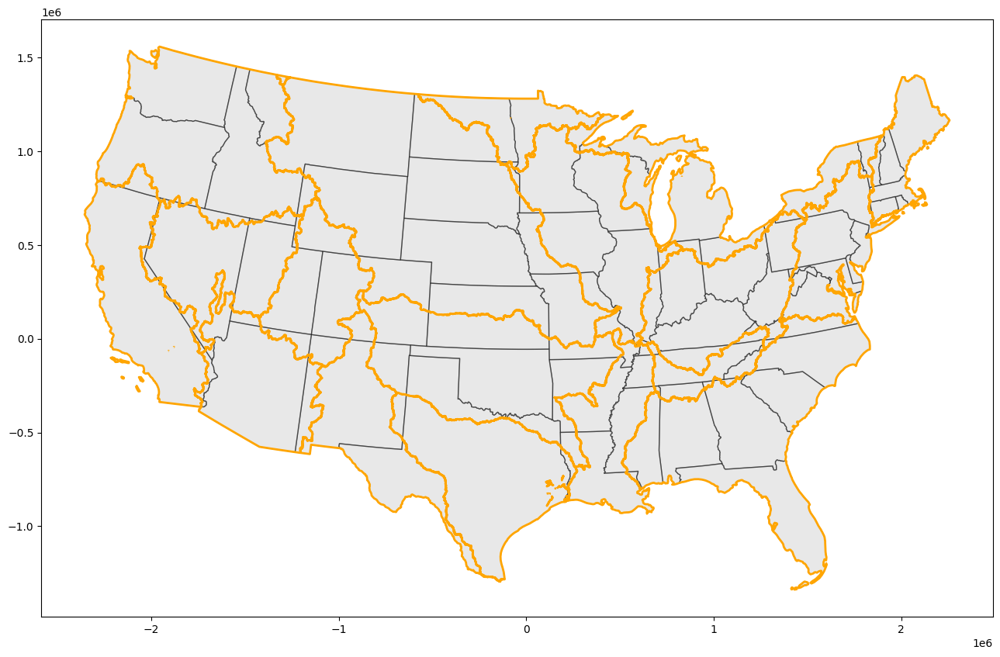

In [241]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(35, 10)) #figsize=(35, 35)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)

huc2 = gpd.read_file('ShapeFiles/_Master_HUC2/master_huc2.shx')
#huc2 = huc2.to_crs(epsg=4269)
huc2 = huc2.to_crs('ESRI:102003')

huc2_clip = gpd.clip(huc2, lower48)

huc2_clip.plot(ax=ax, edgecolor='orange', facecolor='none', linewidth=2.0)

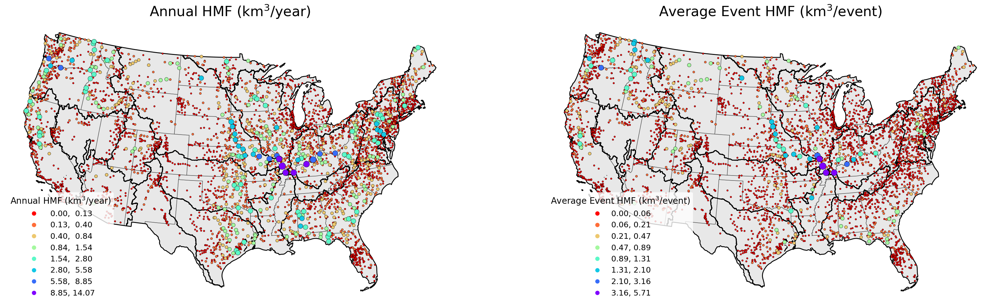

In [243]:
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.patches import FancyArrowPatch

percentile = '90'
date_range = '30'
df_wrong_index = dfs_valid[f'{date_range}_{percentile}']
df = df_wrong_index.reset_index()
extent = 'conus'

fig, ((ax1, ax2)) = plt.subplots(nrows=1, ncols=2, figsize=(35, 10)) #figsize=(35, 35)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
#lower48 = lower48.to_crs(epsg=4269)
lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax1, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)
lower48.plot(ax=ax2, edgecolor='black', facecolor='lightgrey', alpha=0.5, linewidth=1.0)

huc2 = gpd.read_file('ShapeFiles/_Master_HUC2/master_huc2.shx')
#huc2 = huc2.to_crs(epsg=4269)
huc2 = huc2.to_crs('ESRI:102003')

huc2_clip = gpd.clip(huc2, lower48)

huc2_clip.plot(ax=ax1, edgecolor='black', facecolor='none', linewidth=2.0)
huc2_clip.plot(ax=ax2, edgecolor='black', facecolor='none', linewidth=2.0)

# Aquifers
# selected_aq_list_7 = ['High Plains aquifer',
#             'Mississippi River Valley alluvial aquifer',
#             'Central Valley aquifer system',
#             'Floridan aquifer system',
#             'Snake River Plain basaltic-rock aquifers',
#             'Coastal lowlands aquifer system',
#             'Northern Atlantic Coastal Plain aquifer system']

# aq_10 = gpd.read_file('ShapeFiles/Aquifers_USGS_10/Aquifers_USGS_10.shp')
# aq_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
# aq_7 = aq_10[aq_10['AQ_NAME'].isin(selected_aq_list_7)]

# if extent == 'aq25':
#     aq_plot = aq_25

# if extent == 'aq10':
#     aq_plot = aq_10

# if extent == 'aq7':
#     aq_plot = aq_7
    
# aq_plot = aq_plot.to_crs('ESRI:102003')
# aq_plot.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)    

######## Annual HMF ##########
metric = 'annual_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 15
    elif value < classifier.bins[1]:
        return 25
    elif value < classifier.bins[2]:
        return 50
    elif value < classifier.bins[3]:
        return 75
    elif value < classifier.bins[5]:
        return 125
    elif value < classifier.bins[6]:
        return 150
    elif value < classifier.bins[7]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax1, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20
    })

ax1.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 15,
#     'title_fontsize': 15
# }

# legend = ax1.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(35)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax1.transAxes)
# #ax.add_patch(arrow)

######## Event HMF ##########
metric = 'event_hmf'

geo_df = fn.convert_geometry(df)
geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

classifier = mc.NaturalBreaks(geo_df[metric], k=8)
geo_df = geo_df.sort_values(metric, ascending=True)
geo_df.crs = "epsg:4269"
geo_df = geo_df.to_crs('ESRI:102003')

def get_marker_size(value):
    # Define your logic to determine marker size based on the value
    if value < classifier.bins[0]:
        return 15
    elif value < classifier.bins[1]:
        return 25
    elif value < classifier.bins[2]:
        return 50
    elif value < classifier.bins[3]:
        return 75
    elif value < classifier.bins[5]:
        return 125
    elif value < classifier.bins[6]:
        return 150
    elif value < classifier.bins[7]:
        return 200
    else:
        return 250

cmap ='rainbow_r'
#cmap = cm.get_cmap(cmap_name)
sizes = [100, 500, 1000, 1400, 1800, 2200]
bins = classifier.bins
norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
#colors = [cmap(norm(bin)) for bin in bins]

geo_df.plot(ax=ax2, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
            cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
            alpha=1.0, marker='o', 
            markersize=[get_marker_size(value) for value in geo_df[metric]],
            edgecolor='black', linewidth=0.5,
            legend_kwds={
        "loc": "lower left",  # Set the legend location to lower left
        "bbox_to_anchor": (0, 0),  # Adjust the position (x, y) for fine-tuning
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        "facecolor": "white",
        "edgecolor": "none",
        "framealpha": 0.80,
        'fontsize': 18,
        'title_fontsize': 20
    })
            

ax2.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=32)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 15,
#     'title_fontsize': 15
# }

# legend = ax2.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(35)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # Add a scale bar (units in meters, adjust as necessary)
# scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
#                    units="km", dimension="si-length", length_fraction=0.25,
#                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# ax.add_artist(scalebar)
# #scalebar.anchor = (1.5, 3.0)

# x, y, arrow_length = 0.78, 0.9995, 0.05
# ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
#             arrowprops=dict(facecolor='black', width=10, headwidth=20),
#             ha='center', va='center', fontsize=30,
#             xycoords=ax2.transAxes)
# #ax.add_patch(arrow)

# ######## Annual duration ##########
# metric = 'annual_duration'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 15
#     elif value < classifier.bins[1]:
#         return 30
#     elif value < classifier.bins[2]:
#         return 45
#     elif value < classifier.bins[3]:
#         return 60
#     elif value < classifier.bins[5]:
#         return 75
#     else:
#         return 90

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax3, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax3.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# # legend_frmt = {
# #     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
# #     #"reverse": False,
# #     #"loc": "lower right",
# #     "facecolor": "white",
# #     #"alignment": 'center',
# #     "edgecolor": 'none',
# #     "framealpha": 0.80,
# #     'fontsize': 40,
# #     'title_fontsize': 40
# # }

# # legend = ax3.get_legend()
# # for text in legend.get_texts():
# #     text.set_fontsize(35)  # Change the font size as needed
# # plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax3.transAxes)
# # #ax.add_patch(arrow)

# ######## Event duration ##########
# metric = 'event_duration'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 15
#     elif value < classifier.bins[1]:
#         return 30
#     elif value < classifier.bins[2]:
#         return 45
#     elif value < classifier.bins[3]:
#         return 60
#     elif value < classifier.bins[5]:
#         return 75
#     else:
#         return 90

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax4, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax4.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# legend_frmt = {
#     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
#     #"reverse": False,
#     #"loc": "lower right",
#     "facecolor": "white",
#     #"alignment": 'center',
#     "edgecolor": 'none',
#     "framealpha": 0.80,
#     'fontsize': 12,
#     'title_fontsize': 12
# }

# legend = ax4.get_legend()
# for text in legend.get_texts():
#     text.set_fontsize(8)  # Change the font size as needed
# plt.setp(legend.get_title(), fontweight='bold', fontsize=12)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax4.transAxes)
# # #ax.add_patch(arrow)

# ######## Inter-annual ##########
# metric = 'inter_annual%'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 10
#     elif value < classifier.bins[1]:
#         return 10
#     elif value < classifier.bins[2]:
#         return 10
#     elif value < classifier.bins[3]:
#         return 10
#     elif value < classifier.bins[5]:
#         return 10
#     else:
#         return 10

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax5, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax5.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# # legend_frmt = {
# #     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
# #     #"reverse": False,
# #     #"loc": "lower right",
# #     "facecolor": "white",
# #     #"alignment": 'center',
# #     "edgecolor": 'none',
# #     "framealpha": 0.80,
# #     'fontsize': 40,
# #     'title_fontsize': 40
# # }

# # legend = ax5.get_legend()
# # for text in legend.get_texts():
# #     text.set_fontsize(35)  # Change the font size as needed
# # plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax5.transAxes)
# # #ax.add_patch(arrow)

# ######## Intra-annual ##########
# metric = 'intra_annual'

# geo_df = fn.convert_geometry(df)
# geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)

# classifier = mc.NaturalBreaks(geo_df[metric], k=6)
# geo_df = geo_df.sort_values(metric, ascending=True)
# geo_df.crs = "epsg:4269"
# geo_df = geo_df.to_crs('ESRI:102003')

# def get_marker_size(value):
#     # Define your logic to determine marker size based on the value
#     if value < classifier.bins[0]:
#         return 10
#     elif value < classifier.bins[1]:
#         return 15
#     elif value < classifier.bins[2]:
#         return 20
#     elif value < classifier.bins[3]:
#         return 25
#     elif value < classifier.bins[5]:
#         return 30
#     else:
#         return 35

# cmap ='rainbow_r'
# #cmap = cm.get_cmap(cmap_name)
# sizes = [100, 500, 1000, 1400, 1800, 2200]
# bins = classifier.bins
# norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
# #colors = [cmap(norm(bin)) for bin in bins]

# geo_df.plot(ax=ax6, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
#             cmap=cmap, legend=True, #legend_kwds=legend_frmt, 
#             alpha=1.0, marker='o', 
#             markersize=[get_marker_size(value) for value in geo_df[metric]],
#             edgecolor='black', linewidth=0.5)

# ax6.set_title(f'{fn.FLOW_METRIC_UNITS[metric]}', fontsize=14)
# # legend_frmt = {
# #     "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
# #     #"reverse": False,
# #     #"loc": "lower right",
# #     "facecolor": "white",
# #     #"alignment": 'center',
# #     "edgecolor": 'none',
# #     "framealpha": 0.80,
# #     'fontsize': 40,
# #     'title_fontsize': 40
# # }

# # legend = ax6.get_legend()
# # for text in legend.get_texts():
# #     text.set_fontsize(35)  # Change the font size as needed
# # plt.setp(legend.get_title(), fontweight='bold', fontsize=35)

# # # Add a scale bar (units in meters, adjust as necessary)
# # scalebar = ScaleBar(1, location='upper right', font_properties={"size": '35'}, 
# #                    units="km", dimension="si-length", length_fraction=0.25,
# #                     scale_formatter=lambda value, unit: f' {value * 1000} km ', pad = 1)  # 1 unit = 1 meter
# # ax.add_artist(scalebar)
# # #scalebar.anchor = (1.5, 3.0)

# # x, y, arrow_length = 0.78, 0.9995, 0.05
# # ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
# #             arrowprops=dict(facecolor='black', width=10, headwidth=20),
# #             ha='center', va='center', fontsize=30,
# #             xycoords=ax6.transAxes)
# # #ax.add_patch(arrow)


ax1.axis("off")
ax2.axis("off")

#plt.subplots_adjust(left=0.5, right=0.9, bottom=0.5, top=0.9, wspace=0.01, hspace=0.00000005)
plt.tight_layout()

plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/{extent}_vol_compare_{date_range}_{percentile}.png', bbox_inches='tight')

plt.show()

In [229]:
def determine_month(value):
    value_int = int(round(value))
    print(value_int)
    for month, days in month_bins.items():
        if value_int in days:
            return month
            print(month)
    return None  # Return None if out of range (should not happen with valid data)

#test = geo_df['timing'].apply(determine_month)
geo_df['timing'][4240]

determine_month(geo_df['timing'][4240])

235


In [12]:
overwrite = True
date_range = '30'
percentile = '90'

def plot_single_aquifer(aquifer_name, df):
    fig, ax = plt.subplots(figsize=(15, 15))
    #plt.title(f"Multi-Aquifer {metric} Plot for {range} Years & {quantile}th Quantile", loc='center', fontsize=24)
    #plt.title(f'{aquifer_name}', fontsize=24)

    # Lower-48 Plot
    lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
    #lower48 = lower48.to_crs(epsg=4269)
    lower48 = lower48.to_crs('ESRI:102003')
    lower48.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.0)

    #stream_network = stream_network.to_crs(epsg=4269)
    stream_network = gpd.read_file('ShapeFiles/Streams_US/stream_network.shp')
    #stream_network = stream_network.to_crs(epsg=4269)
    stream_network = stream_network.to_crs('ESRI:102003')
    stream_network.plot(ax=ax, color='blue', linewidth=1.5, alpha=0.8, zorder=2) 

    aq_usgs_selected_25 = gpd.read_file('ShapeFiles/Aquifers_USGS_25/Aquifers_USGS_25.shp')
    #aq_usgs_selected_25 = aq_usgs_selected_25.to_crs(epsg=4269)
    aq_usgs_selected_25 = aq_usgs_selected_25.to_crs('ESRI:102003')
    aq_shape_1 = aq_usgs_selected_25[aq_usgs_selected_25['AQ_NAME'] == aquifer_name]
    aq_shape_1.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)
    
    lat = df['dec_lat_va'].tolist()
    long = df['dec_long_va'].tolist()
    geometry = [Point(xy) for xy in zip(long, lat)]
    geo_pts = gpd.GeoDataFrame(geometry=geometry)
    df = df.reset_index()
    geo_df = geo_pts.merge(df, how='left', left_index=True, right_index=True)

    geo_df = geo_df.sort_values(metric, ascending=True)
    geo_df.crs = "epsg:4269"
    geo_df = geo_df.to_crs('ESRI:102003')

    classifier = mc.NaturalBreaks(geo_df[metric], k=6)

    def get_marker_size(value):
        # Define your logic to determine marker size based on the value
        # Annual HMF
        if value < classifier.bins[0]:
            return 100
        elif value < classifier.bins[1]:
            return 500
        elif value < classifier.bins[2]:
            return 1000
        elif value < classifier.bins[3]:
            return 1400
        elif value < classifier.bins[4]:
            return 1800        
        else:
            return 2200

    # All gauges
    cmap ='rainbow_r' #'rainbow_r'
    #cmap = cm.get_cmap(cmap_name)
    sizes = [100, 500, 1000, 1400, 1800, 2200]
    bins = classifier.bins
    norm = mcolors.BoundaryNorm(boundaries=bins, ncolors=256, clip=True)
    #colors = [cmap(norm(bin)) for bin in bins]

    geo_df.plot(ax=ax, column=metric, scheme='user_defined', classification_kwds={'bins': bins}, 
                cmap=cmap, #legend=True, #legend_kwds=legend_frmt, 
                alpha=1.0, marker='o', 
                markersize=[get_marker_size(value) for value in geo_df[metric]],
                edgecolor='black', linewidth=0.5)

    #xmin, xmax, ymin, ymax = fn.set_plot_bounds(aq_shape_1, padding=30.0)

    xmin, ymin, xmax, ymax = aq_shape_1.total_bounds
    # padding = 0.75
    # xmin -= padding
    # ymin -= padding
    # xmax += padding
    # ymax += padding

    padding_factor = 0.05  # 5% padding
    padding_x = (xmax - xmin) * padding_factor
    padding_y = (ymax - ymin) * padding_factor
    
    # Apply padding
    xmin -= padding_x
    ymin -= padding_y
    xmax += padding_x
    ymax += padding_y

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_yticks([])
    ax.set_xticks([])
    
    img_path = f'Saved_Visuals/Aquifers/{date_range}_{percentile}_{aquifer_name}_gages.png'
    fn.save_plot_as_image(img_path, overwrite) 

    plt.show()

#for aquifer_name in aq_names_25:
    #plot_single_aquifer(aquifer_name, dfs_valid[f'{date_range}_{percentile}'])

#aquifer_name = 'Lower Cretaceous aquifers'
#plot_single_aquifer(aquifer_name, dfs_valid[f'{date_range}_{percentile}'])

## Gages with "highest" and "lowest" HMF metrics

In [50]:
df = dfs_aq[f'{date_range}_{percentile}']
df.loc[df['within_aq'].isin(aq_names_10)]
#df['within_aq'].unique()

,site_no,analyze_start,analyze_end,analyze_range,quantile,valid,missing_data%,threshold,hmf_years,annual_hmf,...,dec_lat_va,dec_long_va,data_start,data_end,total_record,state,huc2_code,huc4_code,within_aq,HCDN_2009
6,02369800,1970-10-01,2020-09-30,50,0.95,True,0.0,399.0,49,0.021338,...,31.027680,-86.709957,1967-10-01,2020-09-30,53.0,AL,3,314,Coastal lowlands aquifer system,False
13,02374500,1970-10-01,2020-09-30,50,0.95,True,0.0,759.9,49,0.026177,...,31.418500,-86.986640,1937-10-01,2020-09-30,83.0,AL,3,314,Floridan aquifer system,False
18,02376500,1970-10-01,2020-09-30,50,0.95,True,0.0,2159.0,47,0.093971,...,30.690278,-87.440278,1941-06-09,2020-09-30,79.3,AL,3,314,Coastal lowlands aquifer system,False
111,02471001,1970-10-01,2020-09-30,50,0.95,True,0.0,833.0,48,0.034818,...,30.802965,-88.143336,1951-10-01,2020-09-30,69.0,AL,3,316,Coastal lowlands aquifer system,False
166,09415000,1970-10-01,2020-09-30,50,0.95,True,0.0,767.0,44,0.042905,...,36.891644,-113.924410,1929-10-01,2020-09-30,91.0,AZ,15,1501,Basin and Range basin-fill aquifers,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7567,12459000,1970-10-01,2020-09-30,50,0.95,True,0.0,9720.0,49,0.139611,...,47.583178,-120.619531,1929-03-01,2020-09-30,91.6,WA,17,1702,Pacific Northwest basin-fill aquifers,False
7601,14226500,1970-10-01,2020-09-30,50,0.95,True,0.0,4350.0,48,0.099916,...,46.612890,-121.679255,1911-07-01,2020-09-30,109.3,WA,17,1708,Pacific Northwest basin-fill aquifers,False
7606,14238000,1970-10-01,2020-09-30,50,0.95,True,0.0,14000.0,36,0.260098,...,46.510385,-122.616224,1934-04-01,2020-09-30,86.5,WA,17,1708,Pacific Northwest basin-fill aquifers,False
7886,06657000,1970-10-01,2020-09-30,50,0.95,True,0.0,3240.0,17,0.163464,...,42.241023,-104.627960,1915-01-01,2020-09-30,105.7,WY,10,1018,High Plains aquifer,False


In [48]:
aq_names_10

{'Basin and Range basin-fill aquifers',
 'California Coastal Basin aquifers',
 'Central Valley aquifer system',
 'Coastal lowlands aquifer system',
 'Floridan aquifer system',
 'High Plains aquifer',
 'Mississippi River Valley alluvial aquifer',
 'Northern Atlantic Coastal Plain aquifer system',
 'Pacific Northwest basin-fill aquifers',
 'Snake River Plain basaltic-rock aquifers'}

In [283]:
date_range = '30'
percentile = '90'
metric = 'annual_hmf'

# CONUS
df = dfs_valid[f'{date_range}_{percentile}']

# Top 25
#df = dfs_aq[f'{date_range}_{percentile}']

# Top 10
#df = dfs_aq[f'{date_range}_{percentile}']
#df = df.loc[df['within_aq'].isin(aq_names_10)]

n = 15
high_value = 100
top_value = df.sort_values(by=[metric], ascending=False)[0:n].reset_index()
high_value = df[df[metric] > high_value].reset_index()

high_value = 0.74
low_value = 0.014
mid_annual_value = df[(df[metric] <= high_value) & (df[metric] >= low_value)].reset_index()

#low_annual_hmf = 

print(len(mid_annual_value))
print(len(df))
print(len(mid_annual_value) / len(df) * 100)
#high_annual_hmf

df[metric].describe()

3003
4242
70.79207920792079


count    4242.000000
mean        0.209971
std         0.682611
min         0.000003
25%         0.015643
50%         0.053223
75%         0.162787
max        14.069366
Name: annual_hmf, dtype: float64

In [14]:
dfs_aq[f'{date_range}_{percentile}'][metric]

NameError: name 'dfs_aq' is not defined

In [40]:
date_range = '30'
percentile = '90'
metric = 'annual_hmf'
n = 164
top_annual_hmf = dfs_valid[f'{date_range}_{percentile}'].sort_values(by=[metric], ascending=False)[0:n].reset_index()
high_annual_hmf = dfs_valid[f'{date_range}_{percentile}'][dfs_valid[f'{date_range}_{percentile}']['annual_hmf'] > 3.0].reset_index()
print(len(high_annual_hmf))
print(len(dfs_valid[f'{date_range}_{percentile}']))
print(len(high_annual_hmf) / len(dfs_valid[f'{date_range}_{percentile}']) * 100)
#high_annual_hmf

# Greater than 4 km3 - Missouri R, Ohio R, Susequehana R, Columbia R

32
4242
0.7543611504007544


In [41]:
np.percentile(dfs_valid[f'{date_range}_{percentile}'][metric], 25)

np.float64(0.015642867155247025)

In [197]:
date_range = '30'
percentile = '90'
metric = 'annual_hmf'
df = dfs_valid[f'{date_range}_{percentile}']
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()

In [200]:
print(Q3)
print(upper_whisker)
print(lower_whisker)

0.16278724799988153
0.3835038192668333
3.07289888607744e-06


In [199]:
print(len(upper_outliers[metric]))
print(len(upper_outliers[metric]) / len(df[metric]) * 100)
print(len(lower_outliers[metric]))
print(len(lower_outliers[metric]) / len(df[metric]) * 100)

475
11.197548326261197
0
0.0


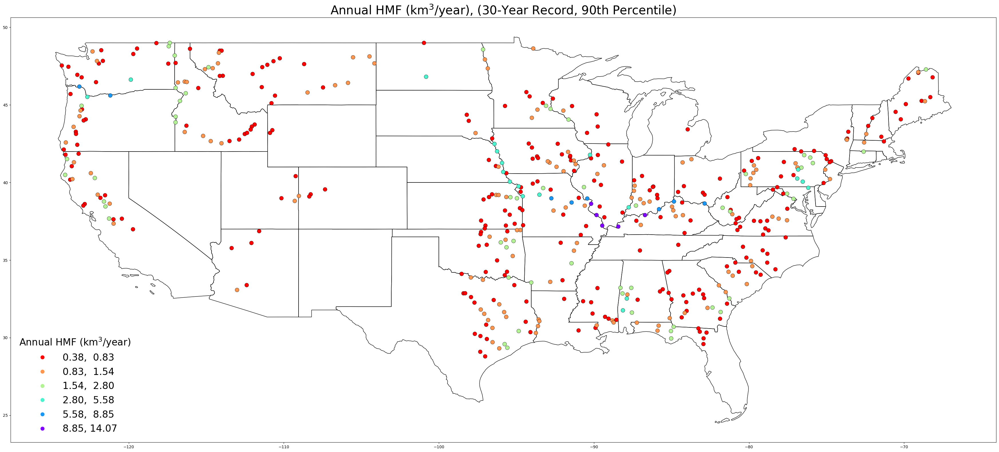

In [53]:
def plot_selected_metric_df(df, metric):
    fig, ax = plt.subplots(figsize=(35, 35))

    plt.title(f'{fn.FLOW_METRIC_UNITS[metric]}, ({date_range}-Year Record, {percentile}th Percentile)', fontsize=30)
    legend_frmt = {
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        #"reverse": False,
        #"loc": "lower right",
        "facecolor": "white",
        #"alignment": 'center',
        "edgecolor": 'none',
        "framealpha": 0.80,
        'fontsize': 24,
        'title_fontsize': 24
    }

    # State basemap
    lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
    lower48 = lower48.to_crs(epsg=4269)
    #lower48 = lower48.to_crs('ESRI:102003')
    lower48.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.0) 


    geo_df = fn.convert_geometry(df)
    geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)
    
    classifier = mc.NaturalBreaks(geo_df[metric], k=6)
    geo_df = geo_df.sort_values(metric, ascending=True)

    # All gauges
    cmap='rainbow_r' #'rainbow_r'
    geo_df.plot(ax=ax, column=metric, scheme='user_defined', classification_kwds={'bins': classifier.bins},
                cmap=cmap, legend=True, legend_kwds=legend_frmt, 
                alpha=1.0, marker='o', 
                markersize=100,
                edgecolor='black', linewidth=0.5)

    #plt.axis("off")

    plt.tight_layout()
    #plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/{metric}_{date_range}_{percentile}.png', bbox_inches='tight')

    plt.show()
    
plot_selected_metric_df(upper_outliers_annual_hmf, metric)

In [153]:
date_range = '30'
percentile = '90'
metric = 'inter_annual%'
df = dfs_valid[f'{date_range}_{percentile}']
Q1 = np.percentile(df[metric], 25)
Q3 = np.percentile(df[metric], 75)
IQR = Q3 - Q1
lower_whisker = np.percentile(df[metric], 0) if Q1 - 1.5 * IQR < np.min(df[metric]) else Q1 - 1.5 * IQR
upper_whisker = np.percentile(df[metric], 100) if Q3 + 1.5 * IQR > np.max(df[metric]) else Q3 + 1.5 * IQR

upper_outliers = df[df[metric] > upper_whisker].reset_index()
lower_outliers = df[df[metric] < lower_whisker].reset_index()
combined_outliers = pd.concat([upper_outliers, lower_outliers], ignore_index=True)

In [154]:
print(Q3)
print(upper_whisker)
print(Q1)
print(lower_whisker)

100.0
100.0
90.0
75.0


In [155]:
print(len(upper_outliers[metric]))
print(len(upper_outliers[metric]) / len(df[metric]) * 100)
print(len(lower_outliers[metric]))
print(len(lower_outliers[metric]) / len(df[metric]) * 100)

0
0.0
369
8.698727015558699


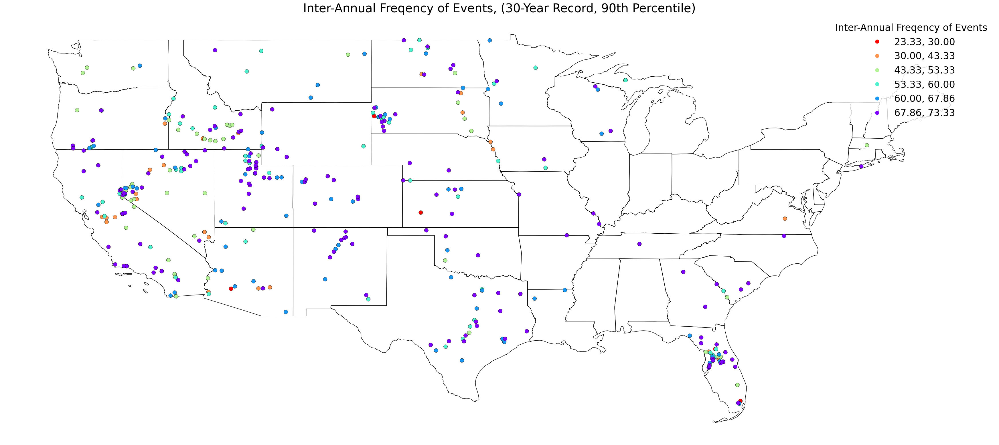

In [156]:
def plot_selected_metric_df(df, metric):
    fig, ax = plt.subplots(figsize=(35, 35))

    plt.title(f'{fn.FLOW_METRIC_UNITS[metric]}, ({date_range}-Year Record, {percentile}th Percentile)', fontsize=30)
    legend_frmt = {
        "title": f"{fn.FLOW_METRIC_UNITS[metric]}",
        #"reverse": False,
        #"loc": "lower right",
        "facecolor": "white",
        #"alignment": 'center',
        "edgecolor": 'none',
        "framealpha": 0.80,
        'fontsize': 24,
        'title_fontsize': 24
    }

    # State basemap
    lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
    lower48 = lower48.to_crs(epsg=4269)
    #lower48 = lower48.to_crs('ESRI:102003')
    lower48.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.0) 


    geo_df = fn.convert_geometry(df)
    geo_df = geo_df.merge(df, how='left', left_index=True, right_index=True)
    
    classifier = mc.NaturalBreaks(geo_df[metric], k=6)
    geo_df = geo_df.sort_values(metric, ascending=True)

    # All gauges
    cmap='rainbow_r' #'rainbow_r'
    geo_df.plot(ax=ax, column=metric, scheme='user_defined', classification_kwds={'bins': classifier.bins},
                cmap=cmap, legend=True, legend_kwds=legend_frmt, 
                alpha=1.0, marker='o', 
                markersize=100,
                edgecolor='black', linewidth=0.5)

    plt.axis("off")

    plt.tight_layout()
    #plt.savefig(f'Saved_Visuals/HMF_metrics/Kirsten/{metric}_{date_range}_{percentile}.png', bbox_inches='tight')

    plt.show()
    
plot_selected_metric_df(combined_outliers, metric)

In [51]:
s1 = pd.merge(upper_outliers_annual_hmf, upper_outliers_event_hmf, how='inner', on=['site_no'])
s1

,index_x,Unnamed: 0_x,site_no,analyze_start_x,analyze_end_x,analyze_range_x,quantile_x,valid_x,missing_data%_x,threshold_x,...,dec_long_va_y,data_start_y,data_end_y,total_record_y,state_y,huc2_code_y,huc4_code_y,within_aq_y,HCDN_2009_y,station_nm_y
0,34,69,2428400,1990-10-01,2020-09-30,30,0.9,True,0.000,73160.0,...,-87.550548,1975-10-01,2020-09-30,45.0,AL,3,315,Mississippi embayment aquifer system,False,ALABAMA RIVER AT CLAIBORNE L&D NEAR MONROEVILLE
1,36,72,2444160,1990-10-01,2019-09-29,29,0.9,True,6.662,23000.0,...,-88.288645,1980-10-01,2019-09-29,39.0,AL,3,316,NaN,False,"TOMBIGBEE RIVER AT BEVILL L&D NR PICKENSVILLE, AL"
2,38,74,2447025,1990-10-01,2020-09-29,30,0.9,True,0.000,30400.0,...,-88.156136,1978-03-17,2020-09-29,42.5,AL,3,316,NaN,False,"TOMBIGBEE R AT HEFLIN L&D NR GAINESVILLE, AL"
3,54,101,2465000,1990-10-01,2020-09-30,30,0.9,True,0.529,19300.0,...,-87.590007,1900-10-01,2020-09-30,120.0,AL,3,316,Southeastern Coastal Plain aquifer system,False,BLACK WARRIOR RIVER AT NORTHPORT AL
4,56,104,2466030,1990-10-01,2019-09-30,29,0.9,True,3.349,23400.0,...,-87.840569,1976-10-01,2019-09-30,43.0,AL,3,316,Southeastern Coastal Plain aquifer system,False,BLACK WARRIOR RIVER AT SELDEN L & D NEAR EUTAW...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
381,4163,7756,5365500,1990-10-01,2020-09-30,30,0.9,True,0.000,10900.0,...,-91.410833,1900-10-01,2020-09-30,120.0,WI,7,705,NaN,False,"CHIPPEWA RIVER AT CHIPPEWA FALLS, WI"
382,4166,7761,5369500,1990-10-01,2020-09-30,30,0.9,True,0.000,16200.0,...,-91.971333,1928-07-09,2020-09-30,92.2,WI,7,705,Cambrian-Ordovician aquifer system,False,"CHIPPEWA RIVER AT DURAND, WI"
383,4177,7783,5400760,1990-10-01,2020-09-30,30,0.9,True,0.009,9750.0,...,-89.827125,1914-05-21,2020-09-30,106.4,WI,7,707,NaN,False,"WISCONSIN RIVER AT WISCONSIN RAPIDS, WI"
384,4179,7790,5404000,1990-10-01,2020-09-30,30,0.9,True,0.000,13800.0,...,-89.756667,1934-10-01,2020-09-30,86.0,WI,7,707,Cambrian-Ordovician aquifer system,False,"WISCONSIN RIVER NEAR WISCONSIN DELLS, WI"


## Single Aquifer Plotting
Plot a single aquifer's water guages based on metric of choice. HUC4 watershed boundaries are the blue zones with the aquifer outline in red.

Controls:

In [2]:
import Src.classes as cl
import Src.func_ko as fn
reload(cl)
reload(fn)

# Dataset selection
aquifer = cl.high_plains_aquifer
range = 30
quantile = 90

try:
    dataset = f'{aquifer.name}_{range}_{quantile}.xlsx'
    datapath = f'Prelim_Data/{aquifer.name}/{dataset}'
    df = pd.read_excel(datapath, sheet_name='site_metrics')
    df_valid, df_invalid = fn.filter_by_valid(df)
    df_valid = df_valid.reset_index(drop=True)
    print(f'Valid Sites: {len(df_valid)} of {len(df)}')
    
except Exception as e:
    print(e)

# Metric to be plotted where metrics are column names from the dataset
metric = 'annual_hmf' #'annual_hmf'

# True if you want to overwrite current images
overwrite = False
save_img = False

Valid Sites: 274 of 327


In [43]:
# New column of values in a column that correspond with a bin size
geo_df['annual_hmf'].min()
geo_df['annual_hmf'].max()

1.88151853570632

## Multiple Aquifer Plotting
Plot multiple aquifers using multiple datasets on a single map by pointing to a directory with aquifer datasets of matching range and quantile.

Controls:

In [33]:
# List of aquifers to plot
aquifers = [cl.arizona_alluvial_aquifer, cl.central_valley_aquifer, cl.columbia_plateau_aquifer, cl.upper_clairborne_aquifer,
            cl.high_plains_aquifer, cl.snake_river_aquifer, cl.coastal_lowlands_aquifer]

range = 30
quantile = 90

# Metric to be plotted where metrics are column names from the dataset
## 'annual_hmf'
## 'six_mo_hmf'
## 'three_mo_hmf'
## 'annual_duration'
## 'inter_annual%'
## 'intra_annual'
## 'timing'
## 'event_duration'
## 'event_hmf'
## 'threshold'
metric = 'threshold'
# True if you want to show HUC4 boundaries (significantly increases runtime)
show_huc4 = True
show_usgs_aqs = True
# True if you want to save image. Overwrite true if you want to overwrite existing image of same name
save_img = True
overwrite = True
# True if you want a context basemap (adds runtime)
basemap = False

show_huc2 = False
show_huc4 = False
show_rateb_aqs = True

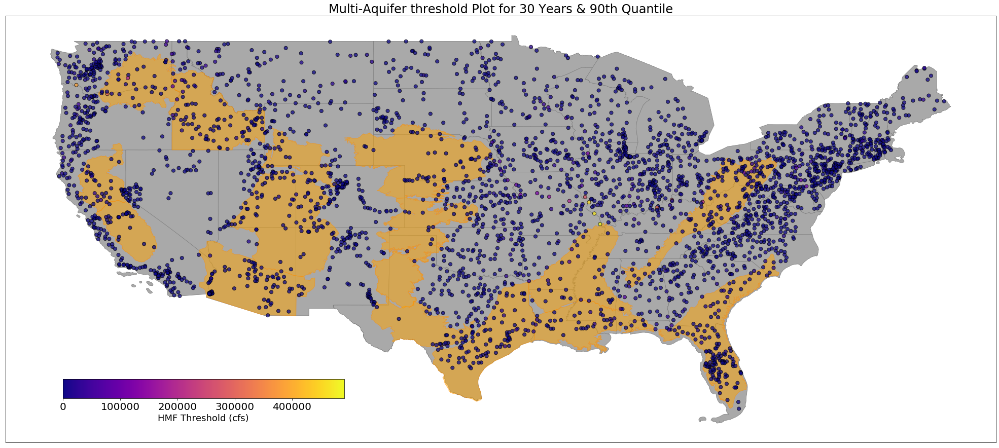

In [35]:
def plot_hmf_metric(metric):    
    fig, ax = plt.subplots(figsize=(35, 35))
    plt.title(f"Multi-Aquifer {metric} Plot for {range} Years & {quantile}th Quantile", loc='center', fontsize=24)

    # Lower-48 Plot
    if not basemap:
        fn.plot_lower_48(ax)

    if show_rateb_aqs:
        fn.plot_rateb_aquifers(ax=ax, edgecolor='darkorange', facecolor='orange', alpha=0.5)

    if show_huc2:
        fn.plot_huc2(ax=ax, codes=[], linewidth=2.0, edgecolor='fuchsia', facecolor='none', alpha=1.0)

    if show_huc4:
        fn.plot_huc4(ax=ax, codes=[], linewidth=2.0, edgecolor='fuchsia', facecolor='none', alpha=1.0)

    # Merge all dataframes so we can accurately track min/max values for colorbar scaling
    # Additonally, plot HUC4 and aquifer boundaries
    # df_all_aq = pd.DataFrame()
    # for aq in aquifers:
    #     try:
    #         df = pd.read_excel(f'{aq.datasets_dir}/{aq.name}_{range}_{quantile}.xlsx', sheet_name='site_metrics')
    #         df_all_aq = pd.concat([df_all_aq.reset_index(drop=True), df.reset_index(drop=True)]).reset_index(drop=True)
    #     except Exception as e:
    #         print(f"ERROR: No dataset found for {aq.name} at {aq.datasets_dir}/{aquifer.name}_{range}_{quantile}.xlsx")

    #     # HUC4 Region Plot
    #     if show_huc4:
    #         for root, dirs, files in os.walk(aq.wb_dir):
    #             #print(root, dirs, files)
    #             if os.path.basename(root).startswith('NHD_H_'):
    #                 if aq.wb_shapefiles in files:
    #                     shapefile_aq_path = os.path.join(root, aq.wb_shapefiles)
    #                     ws_gdf = gpd.read_file(shapefile_aq_path)
    #                     ws_gdf = ws_gdf.to_crs(epsg=4269)
    #                     ws_gdf.plot(ax=ax, edgecolor='blue', alpha=0.30, linewidth=0.5)

    #     # Aquifer Boundary Plot
    #     if show_usgs_aqs:
    #         aq_gdf = gpd.read_file(aq.aq_shapefile)
    #         aq_gdf = aq_gdf.to_crs(epsg=4269)
    #         aq_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=1.00)

    df_all_aq = pd.read_excel(f'Prelim_Data/National_Metrics_{range}_{quantile}.xlsx', sheet_name='site_metrics')


    # L/B/W/H
    cax = fig.add_axes([0.17, 0.37, 0.22, 0.015])

    # Water Gauges Plot
    df_all_aq, _ = fn.filter_by_valid(df_all_aq)
    df_all_aq = df_all_aq.reset_index(drop=True)    
    cmap, mappable = fn.scale_colorbar(df_all_aq, metric)
    geo_df = fn.convert_geometry(df_all_aq)
    bx = geo_df.plot(ax=ax, column=df_all_aq[metric], markersize=200, marker='.', cmap='plasma', edgecolor='black', linewidth=1, alpha=0.75)

    # Colorbar setup
    cbx = plt.colorbar(mappable, cax=cax, pad=2.0, shrink=0.5, orientation='horizontal', alpha=1.0)
    cbx.set_label(fn.FLOW_METRIC_UNITS[metric], size=18)
    cbx.ax.tick_params(labelsize=20)  
    ax.set_yticks([])
    ax.set_xticks([])

    #if basemap:
    #    fn.plot_basemap(ax)

    # Save images if they don't exist or if overwrite is True
    if save_img:
        img_path = f'Saved_Visuals/National_{metric}_{range}_{quantile}.png'
        fn.save_plot_as_image(img_path, overwrite)    
    return
    
plot_hmf_metric(metric)

## National Validity Plot
Plots the validity of every water gauge with daily streamflow data available

In [114]:
data_range = 30
folder = 'National_Validity'
dataset = f'National_Validity.xlsx'
datapath = f'Prelim_Data/{folder}/{dataset}'
lower_48_shp_path = 'ShapeFiles/Lower48/lower48.shp'

show_huc2 = False
show_huc4 = False
show_rateb_aqs = False

save_img= True
overwrite = True

datapath = f'Prelim_Data/National_Validity/National_Validity.xlsx'
df_validity = pd.read_excel(datapath, sheet_name='Sheet1')

In [116]:
data_range = 30

df_30_90['date_range_30'] = df_30_90['valid'] == True
df_50_90['date_range_50'] = df_50_90['valid'] == True
df_30_90['data_cont_30'] = df_30_90['missing_data%'] <= 10
df_50_90['data_cont_50'] = df_50_90['missing_data%'] <= 10

geo_df = fn.convert_geometry(df_30_90)

colors = df_30_90[f'date_range_{data_range}'].astype(str) + df_30_90[f'data_cont_{data_range}'].astype(str)
gdf_green = geo_df[colors == 'TrueTrue']
gdf_yellow = geo_df[colors == 'TrueFalse']
gdf_red = geo_df[colors == 'FalseTrue']
gdf_black = geo_df[colors == 'FalseFalse']

print(f'30-Year Date Range')
print(f'Total Sites with 00060_Mean Data: {len(df_30_90)}')
print(f'Valid Range and Continuity: {len(gdf_green)} ({round(len(gdf_green)/len(df_30_90)*100, 2)}%)')
print(f'Valid Range, Invalid Continuity: {len(gdf_yellow)} ({round(len(gdf_yellow)/len(df_30_90)*100, 2)}%)')
print(f'Invalid Range, Valid Continuity: {len(gdf_red)} ({round(len(gdf_red)/len(df_30_90)*100, 2)}%)')
print(f'Invalid Range and Continuity: {len(gdf_black)} ({round(len(gdf_black)/len(df_30_90)*100, 2)}%)')

data_range = 50

df_30_90['date_range_30'] = df_30_90['valid'] == True
df_50_90['date_range_50'] = df_50_90['valid'] == True
df_30_90['data_cont_30'] = df_30_90['missing_data%'] <= 10
df_50_90['data_cont_50'] = df_50_90['missing_data%'] <= 10

geo_df = fn.convert_geometry(df_50_90)

colors = df_50_90[f'date_range_{data_range}'].astype(str) + df_50_90[f'data_cont_{data_range}'].astype(str)
gdf_green = geo_df[colors == 'TrueTrue']
gdf_yellow = geo_df[colors == 'TrueFalse']
gdf_red = geo_df[colors == 'FalseTrue']
gdf_black = geo_df[colors == 'FalseFalse']

print(f'50-Year Date Range')
print(f'Total Sites with 00060_Mean Data: {len(df_30_90)}')
print(f'Valid Range and Continuity: {len(gdf_green)} ({round(len(gdf_green)/len(df_50_90)*100, 2)}%)')
print(f'Valid Range, Invalid Continuity: {len(gdf_yellow)} ({round(len(gdf_yellow)/len(df_50_90)*100, 2)}%)')
print(f'Invalid Range, Valid Continuity: {len(gdf_red)} ({round(len(gdf_red)/len(df_50_90)*100, 2)}%)')
print(f'Invalid Range and Continuity: {len(gdf_black)} ({round(len(gdf_black)/len(df_50_90)*100, 2)}%)')

30-Year Date Range
Total Sites with 00060_Mean Data: 7858
Valid Range and Continuity: 4241 (53.97%)
Valid Range, Invalid Continuity: 0 (0.0%)
Invalid Range, Valid Continuity: 29 (0.37%)
Invalid Range and Continuity: 3588 (45.66%)
50-Year Date Range
Total Sites with 00060_Mean Data: 7858
Valid Range and Continuity: 3316 (42.2%)
Valid Range, Invalid Continuity: 0 (0.0%)
Invalid Range, Valid Continuity: 13 (0.17%)
Invalid Range and Continuity: 4529 (57.64%)


C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:684: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


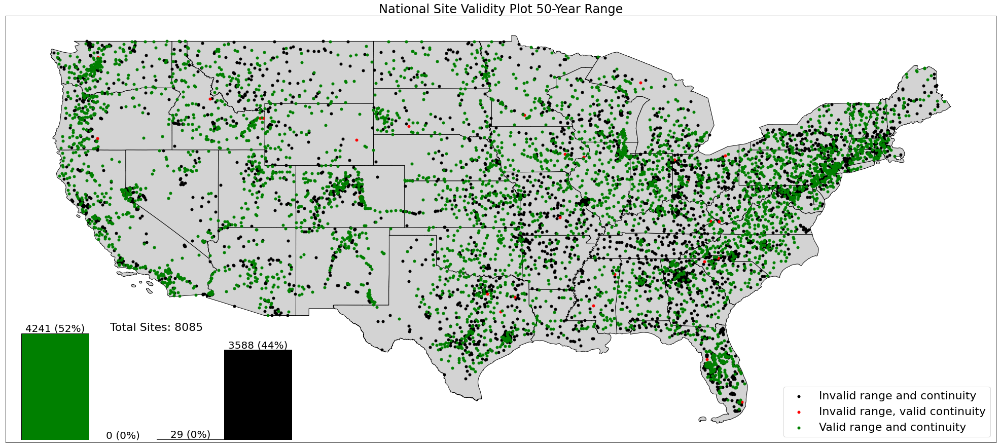

In [118]:
fig, ax = plt.subplots(figsize=(35, 35))
plt.title(f"National Site Validity Plot {data_range}-Year Range", loc='center', fontsize=24)

lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
lower48 = lower48.to_crs(epsg=4269)
#lower48 = lower48.to_crs('ESRI:102003')
lower48.plot(ax=ax, edgecolor='black', facecolor='lightgrey', linewidth=1.0)  

if show_rateb_aqs:
    fn.plot_rateb_aquifers(ax=ax, edgecolor='darkorange', facecolor='orange', alpha=0.5)
    
if show_huc2:
    fn.plot_huc2(ax=ax, codes=[], linewidth=2.0, edgecolor='fuchsia', facecolor='none', alpha=1.0)
    
if show_huc4:
    fn.plot_huc4(ax=ax, codes=[], linewidth=2.0, edgecolor='fuchsia', facecolor='none', alpha=1.0)

data_range = 30

df_30_90['date_range_30'] = df_30_90['valid'] == True
df_50_90['date_range_50'] = df_50_90['valid'] == True
df_30_90['data_cont_30'] = df_30_90['missing_data%'] <= 10
df_50_90['data_cont_50'] = df_50_90['missing_data%'] <= 10

geo_df = fn.convert_geometry(df_30_90)

colors = df_30_90[f'date_range_{data_range}'].astype(str) + df_30_90[f'data_cont_{data_range}'].astype(str)
gdf_green = geo_df[colors == 'TrueTrue']
gdf_yellow = geo_df[colors == 'TrueFalse']
gdf_red = geo_df[colors == 'FalseTrue']
gdf_black = geo_df[colors == 'FalseFalse']

gdf_black.plot(ax=ax, color='black', label='Invalid range and continuity', markersize=100, marker='.', alpha=1.0)
gdf_red.plot(ax=ax, color='red', label='Invalid range, valid continuity', markersize=100, marker='.', alpha=1.0)
gdf_yellow.plot(ax=ax, color='yellow', label='Valid range, invalid continuity', markersize=100, marker='.', alpha=1.0)
gdf_green.plot(ax=ax, color='green', label='Valid range and continuity', markersize=100, marker='.', alpha=1.0)
plt.legend(prop={'size': 22}, loc='lower right')

order = {'TrueTrue': 0, 'TrueFalse': 1, 'FalseTrue': 2, 'FalseFalse': 3}
colors = colors.map(order)
axins = inset_axes(ax, width="30%", height="25%", loc='lower left', axes_kwargs={'frame_on': False})
counts, edges, patches = axins.hist(colors, bins=4, edgecolor='black')

# Define colors for each bin
bin_colors = ['green', 'yellow', 'red', 'black']

# Iterate over patches (bars) and set their colors
for patch, color in zip(patches, bin_colors):
    patch.set_facecolor(color)

for count, edge, patch in zip(counts, edges, patches):
    height = patch.get_height()
    center = edge + (patch.get_x() + patch.get_width() - edge) / 2
    axins.text(center, height - 0.5, f'{count:.0f} ({round(count/len(df_validity)*100, 0):.0f}%)', ha='center', va='bottom', fontsize=20)

axins.set_ylim(0, max(counts) + 5)
axins.set_title(f'Total Sites: {len(df_validity)}', fontsize=22, loc='center')
axins.set_xticks([])
axins.set_yticks([])

ax.set_xticks([])
ax.set_yticks([])

if save_img:
    img_path = f'Saved_Visuals/Valid_gages/natl_validity_aquifers_{data_range}.png'
    #img_path = f'Saved_Visuals/Valid_gages/valid_only_aquifers_{data_range}.png'
    fn.save_plot_as_image(img_path, overwrite) 

plt.show()


# print(f'Total Sites with 00060_Mean Data: {len(df_validity)}')
# print(f'Valid Range and Continuity: {len(gdf_green)} ({round(len(gdf_green)/len(df_validity)*100, 2)}%)')
# print(f'Valid Range, Invalid Continuity: {len(gdf_yellow)} ({round(len(gdf_yellow)/len(df_validity)*100, 2)}%)')
# print(f'Invalid Range, Valid Continuity: {len(gdf_red)} ({round(len(gdf_red)/len(df_validity)*100, 2)}%)')
# print(f'Invalid Range and Continuity: {len(gdf_black)} ({round(len(gdf_black)/len(df_validity)*100, 2)}%)')

## Box Plot and Outliers of HMF Metrics
This plot shows the distribution of each HMF metric, illustrating the mean, median, and interquartile ranges. Outliers (less than the 10th percentile and greater than the 90th percentile) are also selected for each metric

In [76]:
range = 30
quantile = 90

df_natl_30_90 = pd.read_excel(f'Prelim_Data/National_Metrics_{range}_{quantile}.xlsx', sheet_name='site_metrics')
df_natl_30_90, _ = fn.filter_by_valid(df_natl_30_90)

# Metric to be plotted where metrics are column names from the dataset
metric_list = ['threshold', 'annual_hmf', 'six_mo_hmf', 'three_mo_hmf', 'annual_duration', 'event_duration', 'event_hmf', 'inter_annual%', 'intra_annual', 'timing']
## 'annual_hmf'
## 'six_mo_hmf'
## 'three_mo_hmf'
## 'annual_duration'
## 'inter_annual%'
## 'intra_annual'
## 'timing'
## 'event_duration'
## 'event_hmf'
## 'threshold'
metric = 'annual_hmf'

# True if you want to save image. Overwrite true if you want to overwrite existing image of same name
save_img = True
overwrite = True

In [78]:
#df_natl_30_90

In [7]:
def plot_hmf_metric_boxplot(df, metric):
    plt.boxplot(df[metric], showmeans=True)
    #print(boxplot['fliers'])
    plt.xticks(ticks=[1], labels=[f'{metric}'])
    plt.ylabel(fn.FLOW_METRIC_UNITS[metric])
    plt.show()
    return

def get_boxplot_outliers(df, metric):
    boxplot = plt.boxplot(df[metric], showmeans=True)
    plt.xticks(ticks=[1], labels=[f'{metric}'])
    plt.ylabel(fn.FLOW_METRIC_UNITS[metric])
    plt.show()
    
    # Extract outliers
    outliers = [flier.get_ydata() for flier in boxplot['fliers']] # note: boxplot['fliers'] is a graphical object
    # Flatten the outliers list
    outliers = [item for sublist in outliers for item in sublist]
    outlier_site_nos = df.loc[df[metric].isin(outliers), 'site_no']
    return outliers, outlier_site_nos

# All HMF metrics
#for metric in metric_list:
#    plot_hmf_metric_boxplot(df_natl_30_90, metric)

# Singular HMF metric
#plot_hmf_metric_boxplot(df_natl_30_90, metric)
outliers, outlier_site_nos = get_boxplot_outliers(df_natl_30_90, metric)

NameError: name 'df_natl_30_90' is not defined

In [88]:
# Get 10th percentile of sites
def get_percentile_sites(df, metric, percentile):
    df_metric = pd.DataFrame(df[metric])
    threshold = df_metric.quantile(q=percentile, axis=0).iloc[0]
    if percentile < 0.5:
        df_metric_subset = df_metric[df_metric[metric] < threshold]
    else:
        df_metric_subset = df_metric[df_metric[metric] > threshold]
    perctile_site_nos = df.loc[df[metric].isin(df_metric_subset[metric]), 'site_no']
    return perctile_site_nos

perctile_site_nos_10 = get_percentile_sites(df_natl_30_90, metric, 0.1)
perctile_site_nos_90 = get_percentile_sites(df_natl_30_90, metric, 0.9)
print(perctile_site_nos_10)
print(perctile_site_nos_90)

62       9384000
63       9390500
78       9428505
79       9428510
100      9484600
          ...   
4084    12472600
4120     3052500
4214     5406500
4234     6253000
4271    13018300
Name: site_no, Length: 337, dtype: int64
30      2425000
44      2465000
45      2467000
47      2469761
59      9380000
         ...   
4189    5365500
4193    5369500
4207    5400760
4212    5404000
4215    5407000
Name: site_no, Length: 337, dtype: int64


## Monthly HMF Frequency per Aquifer Plot
This plot shows the average frequency in which sites experienced HMF, broken down by month, across an aquifer region. The `mfreq_` datasheets are generated by commented out code in `monthly_hmf()` automatically when aquifer analysis is run. To generate an `mfreq_` dataset, uncomment the code, run aquifer analysis, and then move/rename the resulting dataset to `'Sample_Sheets/mfreq_{aquifer_name}_{range}_{quantile}.csv'`

In [81]:
aquifer = cl.arizona_alluvial_aquifer
range = 30
quantile = 90

hist_data_set = f'mfreq_{aquifer.name}_{range}_{quantile}.csv'
hist_data_path = f'Sample_Sheets/{hist_data_set}'

num_sites = len(pd.read_excel(f'Prelim_Data/{aquifer.name}/{aquifer.name}_{range}_{quantile}.xlsx'))

df_freq = pd.read_csv(hist_data_path)
df_freq = df_freq.sort_values('month')
df_freq = df_freq.drop(columns='Unnamed: 0')
df_freq = df_freq.reset_index(drop=True)
df_freq = df_freq.fillna(0)
df_freq['count'] = df_freq['count'] / num_sites
df_freq['00060_Mean'] = df_freq['00060_Mean'] / num_sites

C:\Users\alekh\AppData\Local\Temp\ipykernel_9116\3884315333.py:12: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(mappable, ax=None)


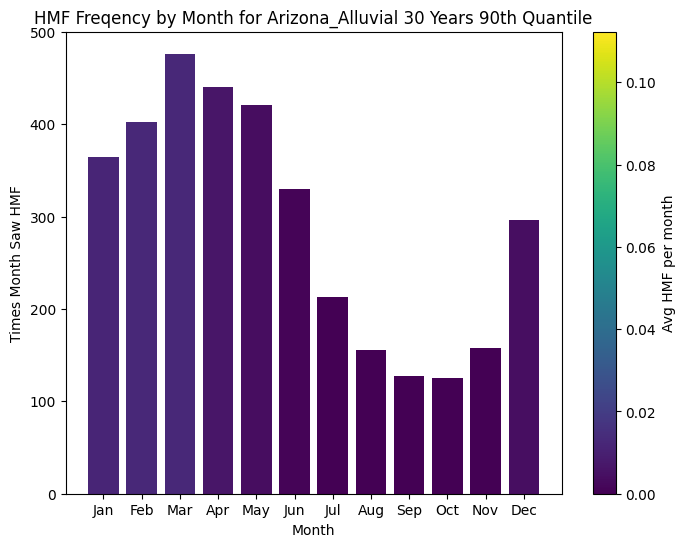

In [82]:
plt.figure(figsize=(8, 6))
plt.xticks(df_freq['month'], [calendar.month_name[int(m)][:3] for m in df_freq['month']], rotation=0)

vmin = df_freq['00060_Mean'].min()
vmax = df_freq['00060_Mean'].max()
norm = mcolors.Normalize(vmin, vmax)
cmap = 'viridis'
mappable = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
mappable.set_array(df_freq['00060_Mean'])

bars = plt.bar(df_freq['month'], df_freq['count'], color=plt.cm.viridis(df_freq['00060_Mean']))
cbar = plt.colorbar(mappable, ax=None)
cbar.set_label('Avg HMF per month')
plt.title(f'HMF Freqency by Month for {aquifer.name} {range} Years {quantile}th Quantile')
plt.xlabel('Month')
plt.ylabel('Times Month Saw HMF')
plt.show()